In [1]:
import numpy as np
import scanpy as sc
import os
import pandas as pd
import scanpy.external as sce
import anndata as ad
import scvelo as scv
import seaborn as sns
import matplotlib.pyplot as plt
sc.settings.verbosity = 3                
sc.settings.set_figure_params(80)                 
sc.settings.file_format_figures = 'pdf'  
sc.settings.savefigs = False            
use_first_n_samples = 0
full_sparse = False
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

# Top-bottom villi score 

## Applying scores to the metadata

In [2]:
def DE_score(adata,de_gene_list,group_name): # Set adata.var.original_name as index for bats and adata.var.Ensembl for mice 
    de_genes = [i for i in de_gene_list if i in adata.var_names]
    celltype_adata = adata.copy()
    sc.pp.normalize_per_cell(celltype_adata, counts_per_cell_after=1e4)
    sc.pp.log1p(celltype_adata)
    sc.pp.scale(celltype_adata)
    sc.tl.score_genes(celltype_adata,gene_list=de_genes, score_name= group_name[:9]+'_score')
    adata_cc_genes = celltype_adata[:, de_genes].copy()
    sc.tl.pca(adata_cc_genes)
    sc.pl.pca_scatter(adata_cc_genes, color=group_name[:9]+'_score')
    adata.obs[group_name[:9]+'_score'] = celltype_adata.obs[group_name[:9]+'_score'].copy()

In [3]:
zonation_genes = pd.read_csv('zonation_score_genes.csv',index_col=0)
zonation_genes.fillna('null',inplace=True)
b= zonation_genes[[col for col in zonation_genes.columns if col.endswith('Bat')]]
m= zonation_genes[[col for col in zonation_genes.columns if col.endswith('Mouse')]]
h= zonation_genes[[col for col in zonation_genes.columns if col.endswith('Human')]]

In [4]:
bat = sc.read("bat_gut.h5ad") 
mouse = sc.read("mouse_SI.h5ad")
human = sc.read("human_SI.h5ad")

filtered out 5557 genes that are detected in less than 3 cells
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 1_score'
    finished: added
    'Cluster 1_score', score of gene set (adata.obs).
    1173 total control genes are used. (0:00:05)
computing PCA
    with n_comps=50
    finished (0:00:03)


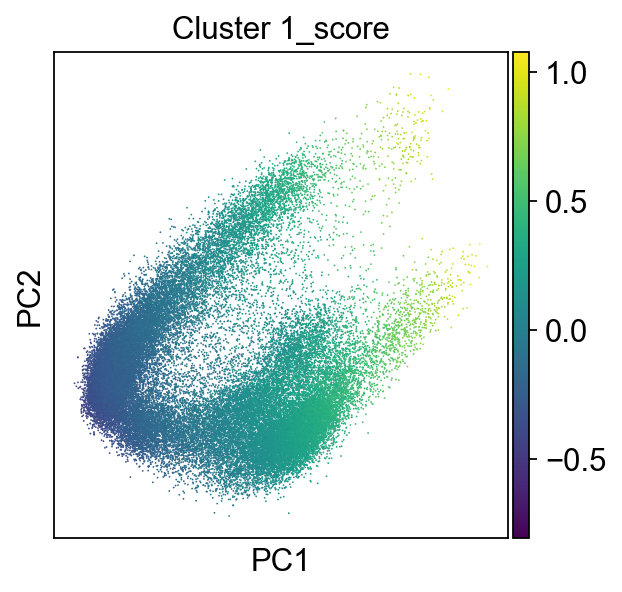

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 2_score'
    finished: added
    'Cluster 2_score', score of gene set (adata.obs).
    1198 total control genes are used. (0:00:05)
computing PCA
    with n_comps=50
    finished (0:00:02)


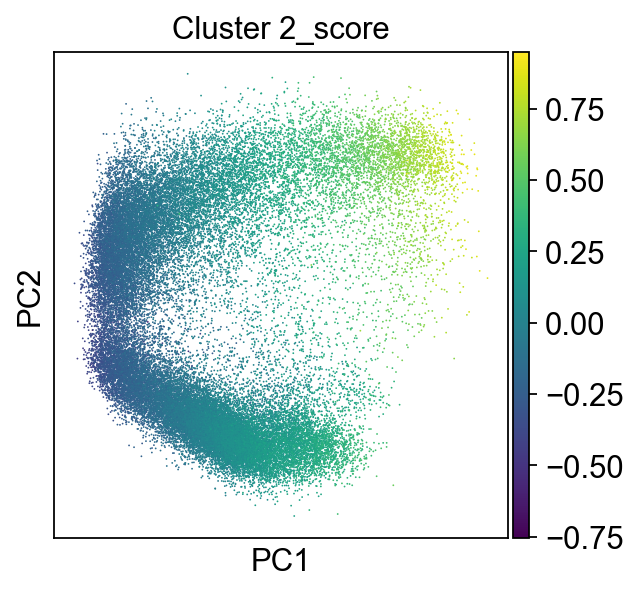

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 3_score'
    finished: added
    'Cluster 3_score', score of gene set (adata.obs).
    1189 total control genes are used. (0:00:05)
computing PCA
    with n_comps=50
    finished (0:00:02)


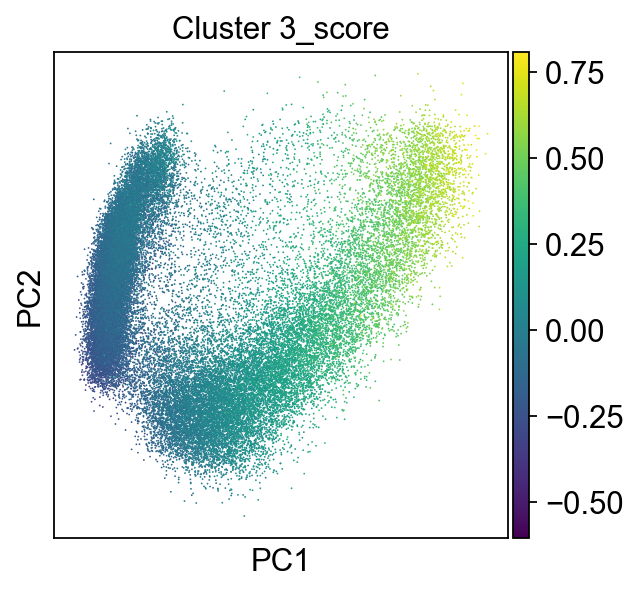

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 4_score'
    finished: added
    'Cluster 4_score', score of gene set (adata.obs).
    1189 total control genes are used. (0:00:07)
computing PCA
    with n_comps=50
    finished (0:00:01)


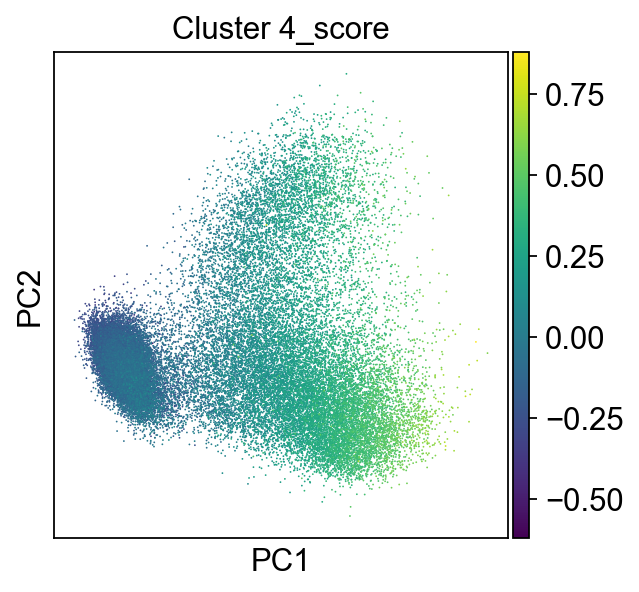

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 5_score'
    finished: added
    'Cluster 5_score', score of gene set (adata.obs).
    1194 total control genes are used. (0:00:11)
computing PCA
    with n_comps=50
    finished (0:00:02)


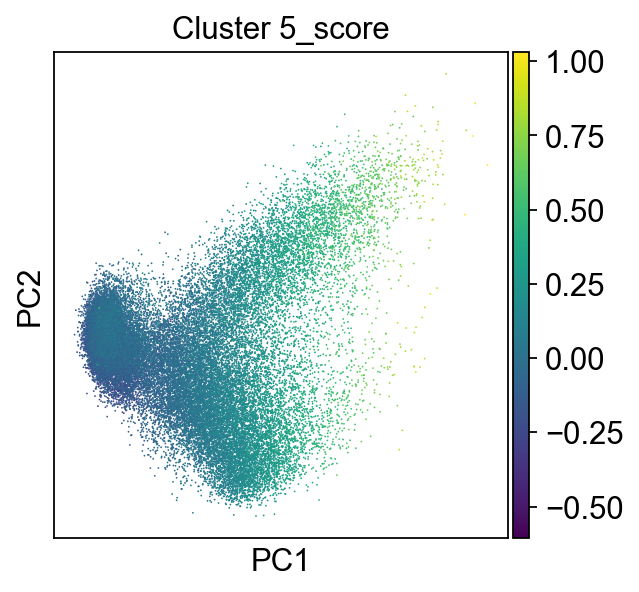

filtered out 8362 genes that are detected in less than 3 cells
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 1_score'
    finished: added
    'Cluster 1_score', score of gene set (adata.obs).
    1180 total control genes are used. (0:00:05)
computing PCA
    with n_comps=50
    finished (0:00:02)


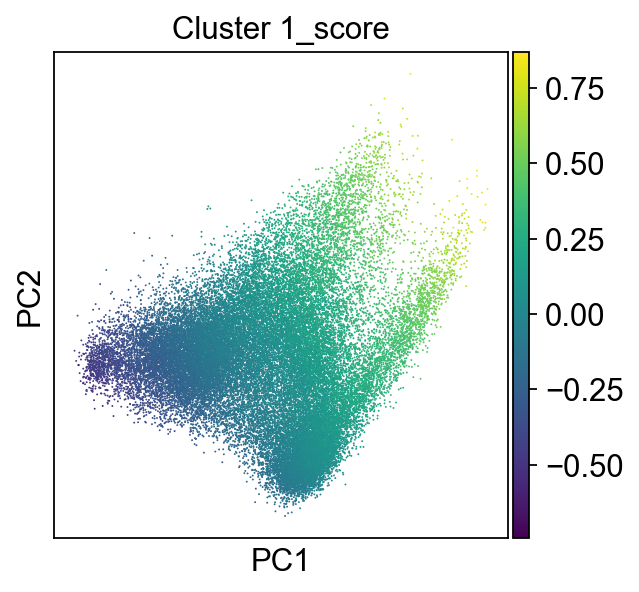

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 2_score'
    finished: added
    'Cluster 2_score', score of gene set (adata.obs).
    1185 total control genes are used. (0:00:05)
computing PCA
    with n_comps=50
    finished (0:00:01)


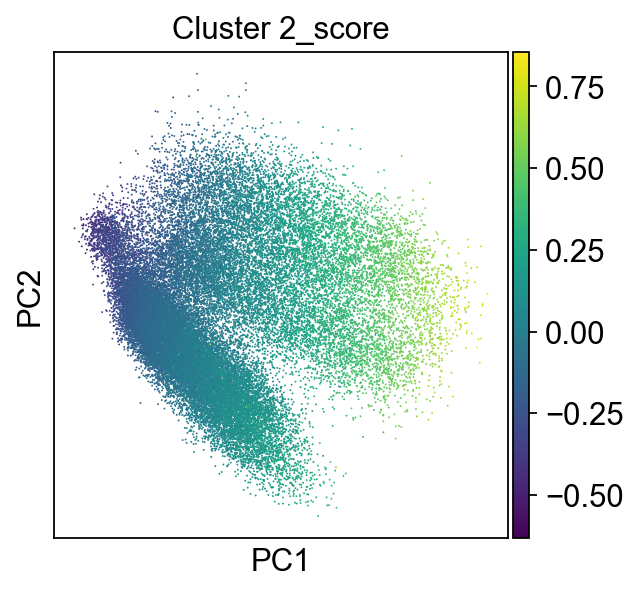

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 3_score'
    finished: added
    'Cluster 3_score', score of gene set (adata.obs).
    1181 total control genes are used. (0:00:05)
computing PCA
    with n_comps=50
    finished (0:00:02)


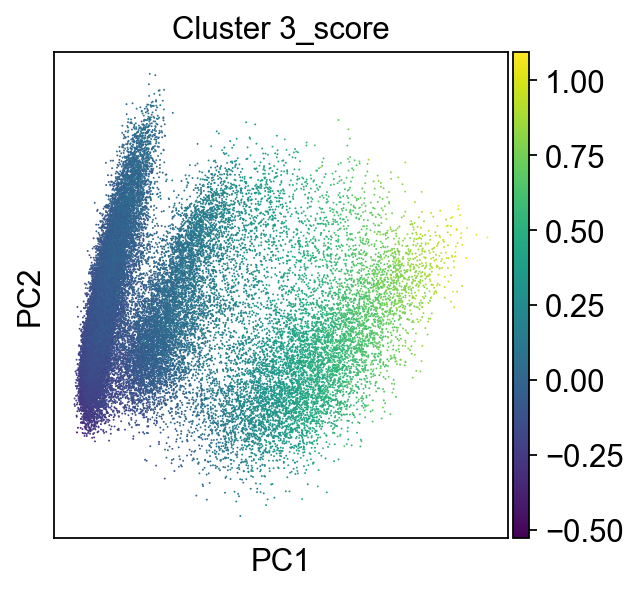

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 4_score'
    finished: added
    'Cluster 4_score', score of gene set (adata.obs).
    1190 total control genes are used. (0:00:05)
computing PCA
    with n_comps=50
    finished (0:00:01)


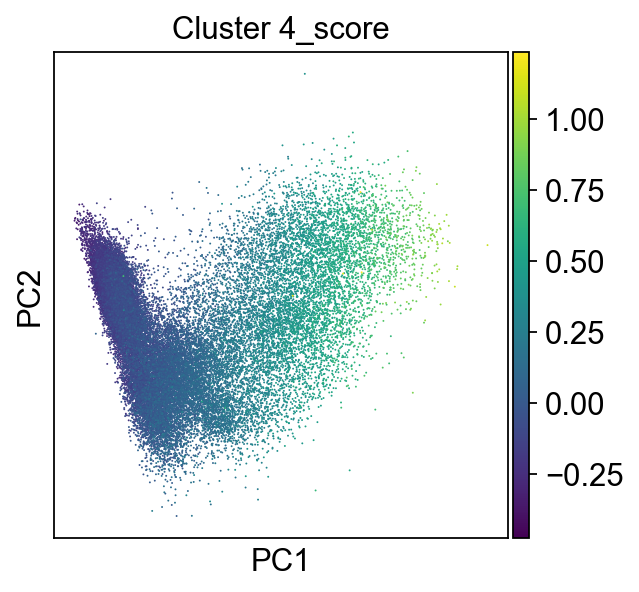

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 5_score'
    finished: added
    'Cluster 5_score', score of gene set (adata.obs).
    1185 total control genes are used. (0:00:18)
computing PCA
    with n_comps=50
    finished (0:00:02)


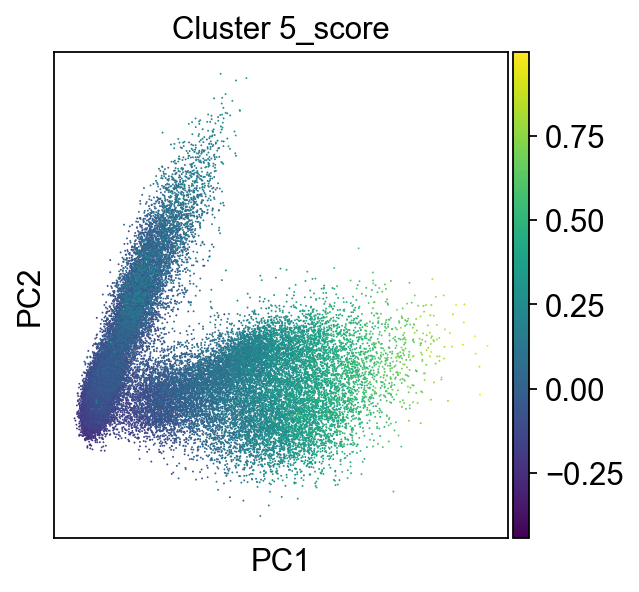

filtered out 30014 genes that are detected in less than 3 cells
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 1_score'
    finished: added
    'Cluster 1_score', score of gene set (adata.obs).
    1173 total control genes are used. (0:00:01)
computing PCA
    with n_comps=50
    finished (0:00:00)


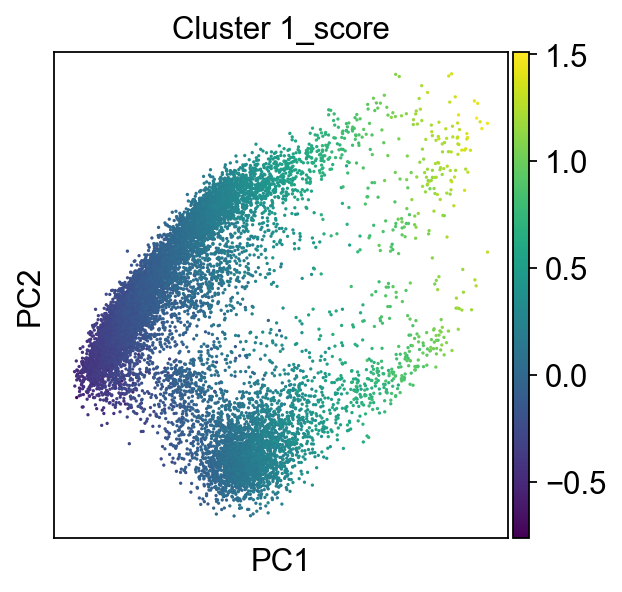

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 2_score'
    finished: added
    'Cluster 2_score', score of gene set (adata.obs).
    1186 total control genes are used. (0:00:03)
computing PCA
    with n_comps=50
    finished (0:00:00)


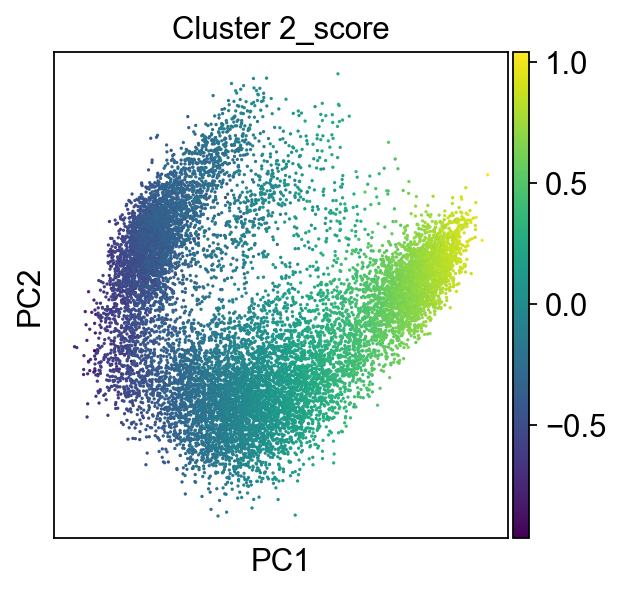

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 3_score'
    finished: added
    'Cluster 3_score', score of gene set (adata.obs).
    1184 total control genes are used. (0:00:01)
computing PCA
    with n_comps=50
    finished (0:00:00)


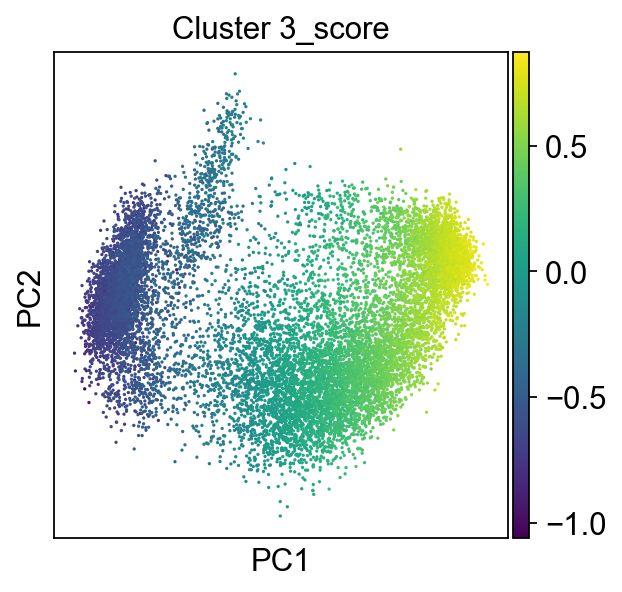

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 4_score'
    finished: added
    'Cluster 4_score', score of gene set (adata.obs).
    1193 total control genes are used. (0:00:01)
computing PCA
    with n_comps=50
    finished (0:00:00)


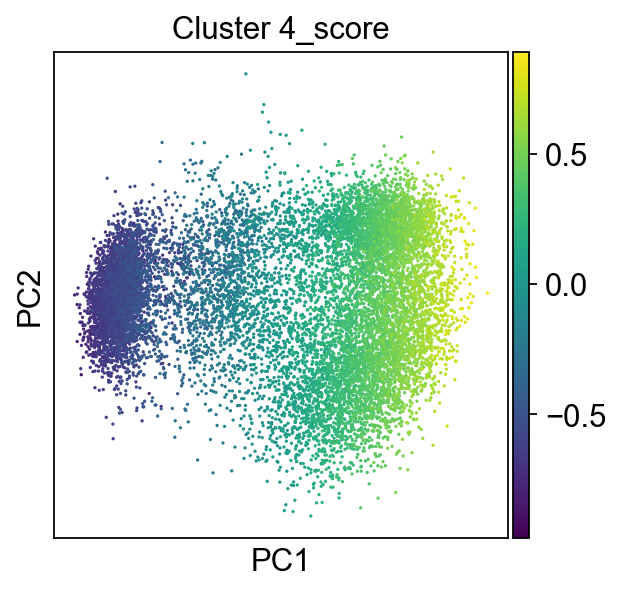

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing score 'Cluster 5_score'
    finished: added
    'Cluster 5_score', score of gene set (adata.obs).
    1183 total control genes are used. (0:00:01)
computing PCA
    with n_comps=50
    finished (0:00:00)


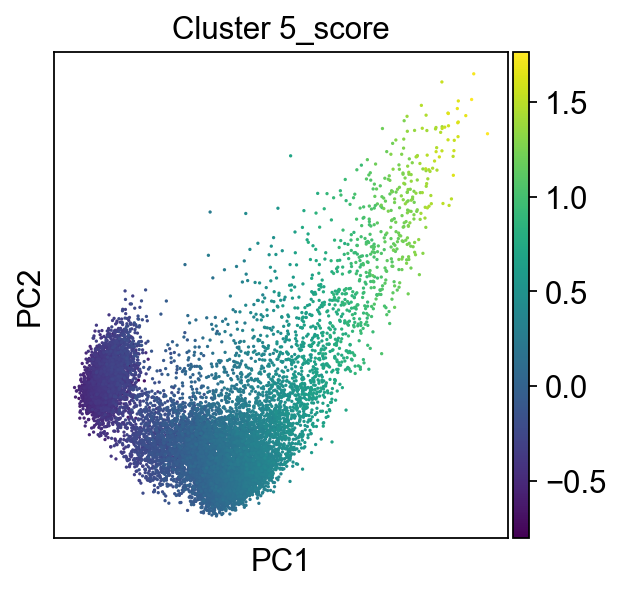

In [5]:
bat_clusters={}
for cluster in b.columns:
    bat_clusters[cluster] = [i for i in b[cluster].to_list() if i!='null']
bat.var.set_index('original_name',inplace=True)    
sc.pp.filter_genes(bat, min_cells=3)
for group in bat_clusters:
    DE_score(bat,bat_clusters[group],group)
bat_metadata = bat.obs.copy()

human_clusters={}
for cluster in h.columns:
    human_clusters[cluster] = [i for i in h[cluster].to_list() if i!='null']
human.var.set_index('gene_ids',inplace=True)    
sc.pp.filter_genes(human, min_cells=3)
for group in human_clusters:
    DE_score(human,human_clusters[group],group)   
human_metadata = human.obs.copy()

mouse_clusters={}
for cluster in m.columns:
    mouse_clusters[cluster] = [i for i in m[cluster].to_list() if i!='null']
mouse.var.set_index('Ensembl',inplace=True)    
sc.pp.filter_genes(mouse, min_cells=3)
for group in mouse_clusters:
    DE_score(mouse,mouse_clusters[group],group)   
mouse_metadata = mouse.obs.copy()

## Dividing into groups - via PCA1 

In [6]:
scores = ['Cluster 1_score','Cluster 2_score','Cluster 3_score','Cluster 4_score','Cluster 5_score']

In [7]:
bat = sc.read("bat_gut.h5ad") 
mouse = sc.read("mouse_SI.h5ad")
human = sc.read("human_SI.h5ad")

bat.obs = bat_metadata.copy()
mouse.obs = mouse_metadata.copy()   # Does not include the replicate of mouse#4 
human.obs = human_metadata.copy()

bat = bat[bat.obs.inter_species_ann=='Enterocyte']
human = human[(human.obs.inter_species_ann=='Enterocyte')&(human.obs.Diagnosis=='Pediatric healthy')]
mouse = mouse[(mouse.obs.inter_species_ann=='Enterocyte')]

filtered out 8823 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts', 'pct_counts_MT']
    sparse input is densified and may lead to high memory use
    finished (0:00:13)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:32)


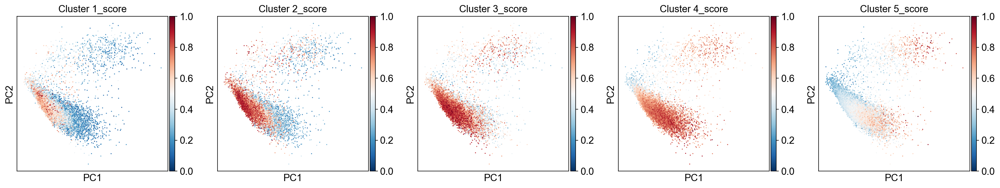

In [8]:
sc.pp.filter_genes(bat, min_cells=3)
sc.pp.normalize_total(bat)
sc.pp.log1p(bat)
sc.pp.highly_variable_genes(bat, min_mean=0.0125, max_mean=3, min_disp=0.5)
bat = bat[:, bat.var.highly_variable]
bat.raw = bat
sc.pp.regress_out(bat, ['total_counts','pct_counts_MT'])
bat_copy_regressed = bat.copy() 
sc.pp.scale(bat, max_value=10)
sc.tl.pca(bat, svd_solver='arpack')
sc.pp.neighbors(bat, n_neighbors=15)
for col in scores: # standardization 
    x = bat.obs[col].copy()
    bat.obs[col] = (x-np.min(x))/(np.max(x)-np.min(x))
del(x)
sc.pl.pca(bat, color=scores,cmap='RdBu_r',save='bat_pca_scores.pdf',ncols=5)

In [9]:
# partition into bottom and top regions

obsm_df = bat.obsm.to_df()
xpca = obsm_df['X_pca1']

threshold =2156 # 15% of the total amount of cells  

sorted_indices = xpca.sort_values().index
bottomvilli = sorted_indices[:threshold]
topvilli = sorted_indices[-threshold:]

location_mapping = {
    **dict.fromkeys(topvilli, 'Top_villi'),
    **dict.fromkeys(bottomvilli, 'Bottom_villi')
}

bat.obs['villi_loc'] = obsm_df.index.map(location_mapping).fillna('Other')
bat.obs['X_pca1'] = xpca.astype('float')

# partition into 5 consecutive bottom-to-top regions
bat.obs['villi_axis'] = ''

n_splits = 5
sorted_indices = list(bat.obs.sort_values(by =['X_pca1']).index)

for i, idx_chunk in enumerate(np.array_split(sorted_indices, n_splits)):
    villi_label = f'V{i + 1}'
    bat.obs.at[idx_chunk, 'villi_axis'] = villi_label

filtered out 16374 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:05)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


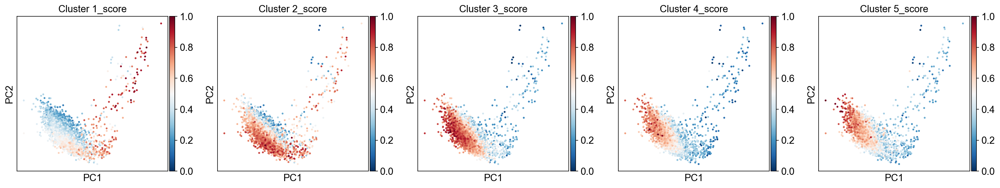

In [10]:
sc.pp.filter_genes(human, min_cells=3)
sc.pp.normalize_total(human)
sc.pp.log1p(human)
sc.pp.highly_variable_genes(human, min_mean=0.0125, max_mean=3, min_disp=0.5)
human = human[:, human.var.highly_variable]
human.raw = human
sc.pp.regress_out(human, ['total_counts','pct_counts_mt'])
human_copy_regressed = human.copy() 
sc.pp.scale(human, max_value=10)
sc.tl.pca(human, svd_solver='arpack')
sc.pp.neighbors(human, n_neighbors=15)
for col in scores:
    x = human.obs[col].copy()
    human.obs[col] = (x-np.min(x))/(np.max(x)-np.min(x))
del(x)
sc.pl.pca(human, color=scores,cmap='RdBu_r',save='human_pca_scores.pdf',ncols=5)

In [11]:
# partition into bottom and top regions

obsm_df = human.obsm.to_df()
xpca = obsm_df['X_pca1']

threshold = int(0.15 * len(xpca)) # 15% of the total amount of cells  

sorted_indices = xpca.sort_values().index
topvilli = sorted_indices[:threshold]
bottomvilli = sorted_indices[-threshold:]

location_mapping = {
    **dict.fromkeys(topvilli, 'Top_villi'),
    **dict.fromkeys(bottomvilli, 'Bottom_villi')
}

human.obs['villi_loc'] = obsm_df.index.map(location_mapping).fillna('Other')
human.obs['X_pca1'] = xpca.astype('float')

# partition into 5 consecutive bottom-to-top regions
human.obs['villi_axis'] = ''

n_splits = 5
sorted_indices = list(human.obs.sort_values(by =['X_pca1'],ascending=False).index)

for i, idx_chunk in enumerate(np.array_split(sorted_indices, n_splits)):
    villi_label = f'V{i + 1}'
    human.obs.at[idx_chunk, 'villi_axis'] = villi_label

filtered out 34137 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts', 'pct_counts_MT']
    sparse input is densified and may lead to high memory use
    finished (0:00:13)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


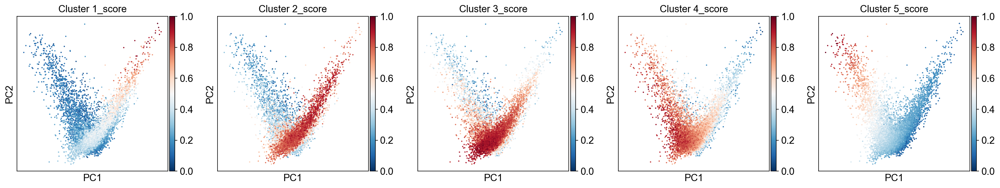

In [12]:
sc.pp.filter_genes(mouse, min_cells=3)
sc.pp.normalize_total(mouse)
sc.pp.log1p(mouse)
sc.pp.highly_variable_genes(mouse, min_mean=0.0125, max_mean=3, min_disp=0.5)
mouse = mouse[:, mouse.var.highly_variable]
mouse.raw = mouse
sc.pp.regress_out(mouse, ['total_counts','pct_counts_MT'])
mouse_copy_regressed = mouse.copy() 
sc.pp.scale(mouse, max_value=10)
sc.tl.pca(mouse, svd_solver='arpack')
sc.pp.neighbors(mouse, n_neighbors=15)
for col in scores:
    x = mouse.obs[col].copy()
    mouse.obs[col] = (x-np.min(x))/(np.max(x)-np.min(x))
del(x)
sc.pl.pca(mouse, color=scores,cmap='RdBu_r',save='mouse_pca_scores.pdf',ncols=5)

In [13]:
# partition into bottom and top regions

obsm_df = mouse.obsm.to_df()
xpca = obsm_df['X_pca1']

threshold = int(0.15 * len(xpca)) # 15% of the total amount of cells  

sorted_indices = xpca.sort_values().index
topvilli = sorted_indices[:threshold]
bottomvilli = sorted_indices[-threshold:]

location_mapping = {
    **dict.fromkeys(topvilli, 'Top_villi'),
    **dict.fromkeys(bottomvilli, 'Bottom_villi')
}

mouse.obs['villi_loc'] = obsm_df.index.map(location_mapping).fillna('Other')
mouse.obs['X_pca1'] = xpca.astype('float')

# partition into 5 consecutive bottom-to-top regions
mouse.obs['villi_axis'] = ''

n_splits = 5
sorted_indices = list(mouse.obs.sort_values(by =['X_pca1'],ascending=False).index)

for i, idx_chunk in enumerate(np.array_split(sorted_indices, n_splits)):
    villi_label = f'V{i + 1}'
    mouse.obs.at[idx_chunk, 'villi_axis'] = villi_label

In [14]:
bat.obs.to_csv('bat_villi_metadata.csv')
human.obs.to_csv('human_villi_metadata.csv')
mouse.obs.to_csv('mouse_villi_metadata.csv')

# DE Top vs Bottom 

- Based on 1 to 1 to 1 orthologs - human, bat ,mouse
- DE is performed between the top and the bottom villus cells 
- Downsampled towards the human - lowest number of cells between the species

In [15]:
scores_pal = {'V1':'#9966FF','V2':'#7a7aeb','V3':'#5494d1','V4':'#26b2b2','V5':'#00CC99'}
scores_pal2 = {'Bottom_villi':'#9966FF','Other':'#5494d1','Top_villi':'#00CC99'}

In [16]:
import random
def down_sampling(adata,n): #n - number of cells in each group - top or bottom villus cells
    top = list(adata[adata.obs.villi_loc=='Top_villi'].obs_names)
    bottom = list(adata[adata.obs.villi_loc=='Bottom_villi'].obs_names)
    random.seed(1)
    barcodes =random.sample(top, k=n) +random.sample(bottom, k=n)
    
    return adata[adata.obs.index.isin(barcodes)]

## Data adjustments - 1:1:1 genes and Top/Bottom cells only

In [17]:
orthology = pd.read_excel("orthology.xlsx",sheet_name='1-1-1 orthologs',)

In [18]:
bat = sc.read("bat_gut.h5ad") 
bat_meta = pd.read_csv('bat_villi_metadata.csv',index_col=0)
bat = bat[bat_meta.index] # Only enterocytes
bat.obs = bat_meta.copy()

mouse = sc.read("mouse_SI.h5ad")
mouse_meta = pd.read_csv('mouse_villi_metadata.csv',index_col=0)
mouse = mouse[mouse_meta.index]
mouse.obs = mouse_meta.copy()

human = sc.read("human_SI.h5ad")
human_meta = pd.read_csv('human_villi_metadata.csv',index_col=0)
human = human[human_meta.index]
human.obs = human_meta.copy()

In [19]:
# Keeping only shared orthologs and adjusting gene names to correspond between all species (eggnog_name)
bat_egg_dict =dict(zip(orthology['bat gene name'],orthology.eggnog_name)) 
human_egg_dict =dict(zip(orthology['human gene id'],orthology.eggnog_name))
mouse_egg_dict =dict(zip(orthology['mouse gene id'],orthology.eggnog_name))
bat.var['Bat_Eggnog'] = bat.var.index.copy()
human.var['human_gene_name'] = human.var.index.copy()
mouse.var['mouse_gene_name'] = mouse.var.index.copy()
bat =  bat[:, bat.var["original_name"].isin(bat_egg_dict.keys())]
human =  human[:, human.var["gene_ids"].isin(human_egg_dict.keys())]
mouse =  mouse[:, mouse.var["Ensembl"].isin(mouse_egg_dict.keys())]

In [20]:
bat =bat[bat.obs.villi_loc!='Other']
mouse =mouse[mouse.obs.villi_loc!='Other']
human =human[human.obs.villi_loc!='Other']

In [21]:
bat = down_sampling(bat,n=int(len(human.obs_names)/2))
human = down_sampling(human,n=int(len(human.obs_names)/2))
mouse = down_sampling(mouse,n=int(len(human.obs_names)/2))

In [22]:
#Mutual gene names for all species
bat.var['eggnog_name'] = bat.var.original_name.map(bat_egg_dict).astype('category')
human.var['eggnog_name'] = human.var.gene_ids.map(human_egg_dict).astype('category') 
mouse.var['eggnog_name'] = mouse.var.Ensembl.map(mouse_egg_dict).astype('category') 

bat.var.set_index('eggnog_name',inplace=True)    
human.var.set_index('eggnog_name',inplace=True)    
mouse.var.set_index('eggnog_name',inplace=True)    

## DE matrices

- Genes will be annotated as -expressed in over 5% of the cells / '3 cells <expression< 5%' / Not expressed if expressent in less than 3 cells 

In [23]:
human_copy = human.copy()
mouse_copy = mouse.copy()
bat_copy = bat.copy()

In [24]:
sc.pp.filter_genes(human, min_cells=int(human.shape[0]/5))
sc.pp.filter_genes(mouse, min_cells=int(mouse.shape[0]/5))
sc.pp.filter_genes(bat, min_cells=int(bat.shape[0]/5))
human_20 = human.var_names.copy()
mouse_20 = mouse.var_names.copy()
bat_20 = bat.var_names.copy()

filtered out 10830 genes that are detected in less than 250 cells
filtered out 9829 genes that are detected in less than 250 cells
filtered out 11551 genes that are detected in less than 250 cells


In [25]:
# Reseting
human = human_copy.copy()
mouse = mouse_copy.copy()
bat = bat_copy.copy()

sc.pp.filter_genes(human, min_cells=int(human.shape[0]/20))
sc.pp.filter_genes(mouse, min_cells=int(mouse.shape[0]/20))
sc.pp.filter_genes(bat, min_cells=int(bat.shape[0]/20))
human_5 = human.var_names.copy()
mouse_5 = mouse.var_names.copy()
bat_5 = bat.var_names.copy()

filtered out 6966 genes that are detected in less than 62 cells
filtered out 7321 genes that are detected in less than 62 cells
filtered out 7724 genes that are detected in less than 62 cells


In [26]:
# Reseting
human = human_copy.copy()
mouse = mouse_copy.copy()
bat = bat_copy.copy()

sc.pp.filter_genes(human, min_cells=3)
sc.pp.filter_genes(mouse, min_cells=3)
sc.pp.filter_genes(bat, min_cells=3)
human_3 = human.var_names.copy()
mouse_3 = mouse.var_names.copy()
bat_3 = bat.var_names.copy()

filtered out 3878 genes that are detected in less than 3 cells
filtered out 4675 genes that are detected in less than 3 cells
filtered out 4296 genes that are detected in less than 3 cells


In [27]:
human = human_copy.copy()
mouse = mouse_copy.copy()
bat = bat_copy.copy()

In [28]:
bat_expressed20  = {}
for i in bat_20:
    bat_expressed20[i] = '>20%'
mouse_expressed20  = {}
for i in mouse_20:
    mouse_expressed20[i] = '>20%'
human_expressed20  = {}
for i in human_20:
    human_expressed20[i] = '>20%'

bat_expressed5  = {}
for i in bat_5:
    bat_expressed5[i] = '>5%'
mouse_expressed5  = {}
for i in mouse_5:
    mouse_expressed5[i] = '>5%'
human_expressed5  = {}
for i in human_5:
    human_expressed5[i] = '>5%'

bat_expressed3  = {}
for i in bat_3:
    if i in bat_expressed5:
        pass
    else:
        bat_expressed3[i] = '3 cells <expression< 5%'
mouse_expressed3  = {}
for i in mouse_3:
    if i in mouse_expressed5:
        pass
    else:
        mouse_expressed3[i] = '3 cells <expression< 5%'
human_expressed3  = {}
for i in human_3:
    if i in human_expressed5:
        pass
    else:
        human_expressed3[i] = '3 cells <expression< 5%'
        
bat_not_expressed  = {}
for i in bat.var_names:
    if (i in bat_expressed5)|(i in bat_expressed3) :
        pass
    else:
        bat_not_expressed[i] = 'not expressed'
mouse_not_expressed  = {}
for i in mouse.var_names:
    if (i in mouse_expressed5)|(i in mouse_expressed3) :
        pass
    else:
        mouse_not_expressed[i] = 'not expressed'
human_not_expressed  = {}
for i in human.var_names:
    if (i in human_expressed5)|(i in human_expressed3) :
        pass
    else:
        human_not_expressed[i] = 'not expressed'

human_expression = {**human_expressed3, **human_expressed5, **human_expressed20,**human_not_expressed}
mouse_expression = {**mouse_expressed3, **mouse_expressed5, **mouse_expressed20,**mouse_not_expressed}
bat_expression = {**bat_expressed3, **bat_expressed5, **bat_expressed20,**bat_not_expressed}

In [29]:
sc.pp.normalize_total(human)
sc.pp.log1p(human)

sc.tl.rank_genes_groups(human, 'villi_loc', method='wilcoxon',pts=True,)
pd.set_option("display.max_columns", None)
pd.DataFrame(human.uns['rank_genes_groups']['names']).head(20)
result = human.uns['rank_genes_groups']
groups = result['names'].dtype.names

human_de = pd.DataFrame(
{group + '_' + key[:]: result[key][group]
for group in groups for key in ['names','logfoldchanges','pvals','pvals_adj']})
human_de.drop(columns=['Bottom_villi_names','Bottom_villi_logfoldchanges','Bottom_villi_pvals','Bottom_villi_pvals_adj',],inplace=True)
human_de['expression'] = human_de['Top_villi_names'].map(human_expression).astype('str')
human_de.set_index('Top_villi_names',inplace=True)
pts_dict_top = dict(zip(human.uns['rank_genes_groups']["pts"].index,human.uns['rank_genes_groups']["pts"]['Top_villi']))
human_de['top_pts'] = human_de.index.map(pts_dict_top).astype('float')
pts_dict_Bottom = dict(zip(human.uns['rank_genes_groups']["pts"].index,human.uns['rank_genes_groups']["pts"]['Bottom_villi']))
human_de['bottom_pts'] = human_de.index.map(pts_dict_Bottom).astype('float')

normalizing counts per cell
    finished (0:00:00)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


In [30]:
sc.pp.normalize_total(bat)
sc.pp.log1p(bat)

sc.tl.rank_genes_groups(bat, 'villi_loc', method='wilcoxon',pts=True,)
pd.set_option("display.max_columns", None)
pd.DataFrame(bat.uns['rank_genes_groups']['names']).head(20)
result = bat.uns['rank_genes_groups']
groups = result['names'].dtype.names

bat_de = pd.DataFrame(
{group + '_' + key[:]: result[key][group]
for group in groups for key in ['names','logfoldchanges','pvals','pvals_adj']})
bat_de.drop(columns=['Bottom_villi_names','Bottom_villi_logfoldchanges','Bottom_villi_pvals','Bottom_villi_pvals_adj',],inplace=True)
bat_de['expression'] = bat_de['Top_villi_names'].map(bat_expression).astype('str')
bat_de.set_index('Top_villi_names',inplace=True)
pts_dict_top = dict(zip(bat.uns['rank_genes_groups']["pts"].index,bat.uns['rank_genes_groups']["pts"]['Top_villi']))
bat_de['top_pts'] = bat_de.index.map(pts_dict_top).astype('float')
pts_dict_Bottom = dict(zip(bat.uns['rank_genes_groups']["pts"].index,bat.uns['rank_genes_groups']["pts"]['Bottom_villi']))
bat_de['bottom_pts'] = bat_de.index.map(pts_dict_Bottom).astype('float')

normalizing counts per cell
    finished (0:00:00)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


In [31]:
sc.pp.normalize_total(mouse)
sc.pp.log1p(mouse)

sc.tl.rank_genes_groups(mouse, 'villi_loc', method='wilcoxon',pts=True,)
pd.set_option("display.max_columns", None)
pd.DataFrame(mouse.uns['rank_genes_groups']['names']).head(20)
result = mouse.uns['rank_genes_groups']
groups = result['names'].dtype.names

mouse_de = pd.DataFrame(
{group + '_' + key[:]: result[key][group]
for group in groups for key in ['names','logfoldchanges','pvals','pvals_adj']})
mouse_de.drop(columns=['Bottom_villi_names','Bottom_villi_logfoldchanges','Bottom_villi_pvals','Bottom_villi_pvals_adj',],inplace=True)
mouse_de['expression'] = mouse_de['Top_villi_names'].map(mouse_expression).astype('str')
mouse_de.set_index('Top_villi_names',inplace=True)
pts_dict_top = dict(zip(mouse.uns['rank_genes_groups']["pts"].index,mouse.uns['rank_genes_groups']["pts"]['Top_villi']))
mouse_de['top_pts'] = mouse_de.index.map(pts_dict_top).astype('float')
pts_dict_Bottom = dict(zip(mouse.uns['rank_genes_groups']["pts"].index,mouse.uns['rank_genes_groups']["pts"]['Bottom_villi']))
mouse_de['bottom_pts'] = mouse_de.index.map(pts_dict_Bottom).astype('float')

normalizing counts per cell
    finished (0:00:00)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


In [32]:
#Merging DE dataframes
batmouse= pd.merge(bat_de,mouse_de , left_index=True, right_index=True,suffixes=('_bat', '_mouse'),)
de = pd.merge(batmouse,human_de , left_index=True, right_index=True,)
de.rename(columns={'Top_villi_logfoldchanges':'Top_villi_logfoldchanges_human','Top_villi_pvals':'Top_villi_pvals_human','Top_villi_pvals_adj':'Top_villi_pvals_adj_human','expression':'expression_human','top_pts':'top_pts_human','bottom_pts':'bottom_pts_human'},inplace=True)

Different measures for the DE matrix:
- Delta_logFC_bat_mouse 
- -logP/Q values
- Other measures for sorting of the dataframe
- Ensembel human - for the gProfiler search - Human gene names

In [33]:
for i in de.index:
    if de.at[i,'expression_bat'] =='not expressed':
        de.at[i,'Top_villi_logfoldchanges_bat'] =float(0)
    if de.at[i,'expression_mouse'] =='not expressed':
        de.at[i,'Top_villi_logfoldchanges_mouse'] =float(0)
    if de.at[i,'expression_human'] =='not expressed':
        de.at[i,'Top_villi_logfoldchanges_human'] =float(0)

de['status_bat'] = ''
de['status_mouse'] = ''
de['status_human'] = ''

for i in de.index:
    for spe in ['_bat','_mouse','_human']:
        if de.at[i,'Top_villi_logfoldchanges'+spe] >0:
            de.at[i,'status'+spe] = 'top'
        elif de.at[i,'Top_villi_logfoldchanges'+spe] ==0:
            de.at[i,'status'+spe] = '0'
        else:
            de.at[i,'status'+spe] = 'bottom'        

# Delta_logFC
             
de['abs_delta_logFC_bat_mouse'] = abs(de['Top_villi_logfoldchanges_bat'] -de['Top_villi_logfoldchanges_mouse'])
de['abs_delta_logFC_bat_human'] =  abs(de['Top_villi_logfoldchanges_bat'] -de['Top_villi_logfoldchanges_human'])
de['abs_delta_logFC_mouse_human'] =  abs(de['Top_villi_logfoldchanges_mouse'] -de['Top_villi_logfoldchanges_human'])

de['delta_logFC_bat_mouse'] = de['Top_villi_logfoldchanges_bat'] -de['Top_villi_logfoldchanges_mouse']
de['delta_logFC_bat_human'] =  de['Top_villi_logfoldchanges_bat'] -de['Top_villi_logfoldchanges_human']
de['delta_logFC_mouse_human'] =  de['Top_villi_logfoldchanges_mouse'] -de['Top_villi_logfoldchanges_human']

de['delta_logFC_mouse_bat'] = de['Top_villi_logfoldchanges_mouse'] -de['Top_villi_logfoldchanges_bat']
de['delta_logFC_human_bat'] = de['Top_villi_logfoldchanges_human'] -de['Top_villi_logfoldchanges_bat']

de['min_delta'] = float() # Sorting by the lowest delta between the two species (human/mouse)    
for i in de.index:
    de.at[i,'min_delta'] = min(de.at[i,'delta_logFC_bat_mouse'],(de.at[i,'delta_logFC_bat_human']))

de['min_delta_2'] = float(0)  # Sorting by the lowest delta between the two species (vs bat) 
for i in de.index:
    de.at[i,'min_delta_2'] = min(de.at[i,'delta_logFC_mouse_bat'],(de.at[i,'delta_logFC_human_bat']))
    
de['max_delta'] = float() # Sorting by the highest delta between the two species (vs human/mouse)    
for i in de.index:
    de.at[i,'max_delta'] = max(de.at[i,'delta_logFC_bat_mouse'],(de.at[i,'delta_logFC_bat_human']))

de['max_delta_2'] = float() # Sorting by the highest delta between the two species (vs bat)    
for i in de.index:
    de.at[i,'max_delta_2'] = max(de.at[i,'delta_logFC_mouse_bat'],(de.at[i,'delta_logFC_human_bat']))
# -logQ/P values

de['minus_logPval_bat'] = -np.log10(de['Top_villi_pvals_bat'])
de['minus_logPval_mouse'] = -np.log10(de['Top_villi_pvals_mouse'])
de['minus_logPval_human'] = -np.log10(de['Top_villi_pvals_human'])

de['minus_logQval_bat'] = -np.log10(de['Top_villi_pvals_adj_bat'])
de['minus_logQval_mouse'] = -np.log10(de['Top_villi_pvals_adj_mouse'])
de['minus_logQval_human'] = -np.log10(de['Top_villi_pvals_adj_human'])

de['max_qval_human_mouse'] = float()  
for i in de.index:
    de.at[i,'max_qval_human_mouse'] = max(de.at[i,'Top_villi_pvals_adj_mouse'],(de.at[i,'Top_villi_pvals_adj_human']))

# Human Ensembel gene names
    
de['Ens_human'] = de.index.map(dict(zip(orthology.eggnog_name,orthology['human gene id']))).astype('category')

de.to_csv('top_bottom_DE_matrix.csv')

## Human DE for gene age analysis

In [34]:
# DE that is not restricted to shared orthologs 
human = sc.read("human_SI.h5ad")
human_meta = pd.read_csv('human_villi_metadata.csv',index_col=0)
human = human[human_meta.index]
human.obs = human_meta.copy()
human = human[human.obs.villi_loc!='Other']
human.var.set_index('gene_ids',inplace=True) 

In [35]:
sc.pp.filter_genes(human, min_cells=int(human.shape[0]/5)) # Only genes expressed in over 20% of the cells 
sc.pp.normalize_total(human)
sc.pp.log1p(human)
sc.tl.rank_genes_groups(human, 'villi_loc', method='wilcoxon') # Can also be 'cell_type' once annotated
pd.set_option("display.max_columns", None)
pd.DataFrame(human.uns['rank_genes_groups']['names']).head(20)
result = human.uns['rank_genes_groups']
groups = result['names'].dtype.names
human_de = pd.DataFrame(
{group + '_' + key[:]: result[key][group]
for group in groups for key in ['names','logfoldchanges','pvals','pvals_adj']})
human_de.drop(columns=['Bottom_villi_names','Bottom_villi_logfoldchanges','Bottom_villi_pvals','Bottom_villi_pvals_adj'],inplace=True)
human_de.set_index('Top_villi_names',inplace=True)

filtered out 29265 genes that are detected in less than 250 cells
normalizing counts per cell
    finished (0:00:00)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


## Gene age

### By top-bottom villi DE

- All genes- the analysis is not restricted to shared orthologs. Based on human gene age measures
- Only genes that are expressed in over 20% of the cells with a Q value of at least 0.01 
- Based on 500 top genes (lowest Q value) even if not all have gene age data

In [36]:
wagner_geneage = pd.read_csv(r"C:\Users\TzachiHNB5\Documents\Project_barrier_immune\scanpy\gut_analysis\top_bottom\gene_age\HUMAN_PPODv4_Nens_wagner1.0_age-depth.protein_list.txt",delimiter='\t',names =['index','0','1'])
wagner_geneage['1'] = wagner_geneage['1'].astype('str')
wagner_geneage = wagner_geneage[wagner_geneage['1']!='nan']
wagner_geneage = wagner_geneage[wagner_geneage['1'].isin([str(i) for i in range(0,20)])]
wagner = dict(zip(wagner_geneage.index,wagner_geneage['1']))
human_de['Wagner_Ensembl'] = human_de.index.map(wagner).astype('float')

In [37]:
OrthoMCL = pd.read_csv(r"C:\Users\TzachiHNB5\Documents\Project_barrier_immune\scanpy\gut_analysis\top_bottom\gene_age\HUMAN_PPODv4_PTHR7-OrthoMCL_dollo_age-depth.protein_list.txt",names=['0','1','gene'],delimiter='\t')
OrthoMCL.dropna(inplace=True)
OrthoMCL['gene'] = OrthoMCL['gene'].astype('str')
OrthoMCL = OrthoMCL[OrthoMCL.gene!='nan']
OrthoMCL = OrthoMCL[OrthoMCL.gene.isin([str(i) for i in range(0,20)])] # Correction for some non-numerical values
OrthoMCL_dict= dict(zip(OrthoMCL.index,OrthoMCL.gene))
human_de['OrthoMCL_dollo'] = human_de.index.map(OrthoMCL_dict).astype('float')

In [38]:
OrthoMCL2 = pd.read_csv(r"C:\Users\TzachiHNB5\Documents\Project_barrier_immune\scanpy\gut_analysis\top_bottom\gene_age\HUMAN_PPODv4_OrthoMCL_wagner1.0_age-depth.protein_list.txt",names=['0','1','gene'],delimiter='\t')
OrthoMCL2['gene'] = OrthoMCL2['gene'].astype('str')
OrthoMCL2 = OrthoMCL2[OrthoMCL2.gene!='nan']
OrthoMCL2 = OrthoMCL2[OrthoMCL2.gene.isin([str(i) for i in range(0,20)])] # Correction for some non-numerical values
OrthoMCL2_dict= dict(zip(OrthoMCL2.index,OrthoMCL2.gene))
human_de['OrthoMCL_Wagner'] = human_de.index.map(OrthoMCL2_dict).astype('float')

In [39]:
top_genes = list(human_de[(human_de.Top_villi_pvals_adj<0.01)&(human_de.Top_villi_logfoldchanges>0)].sort_values(by='Top_villi_pvals_adj').head(500).index)
bottom_genes = list(human_de[(human_de.Top_villi_pvals_adj<0.01)&(human_de.Top_villi_logfoldchanges<0)].sort_values(by='Top_villi_pvals_adj').head(500).index)
human_de = human_de[human_de.index.isin(top_genes+bottom_genes)]
human_de['Status'] = ''
for i in human_de.index:
    if human_de.at[i,'Top_villi_logfoldchanges']>0:
        human_de.at[i,'Status'] = 'Top'
    else:
        human_de.at[i,'Status'] = 'Bottom'

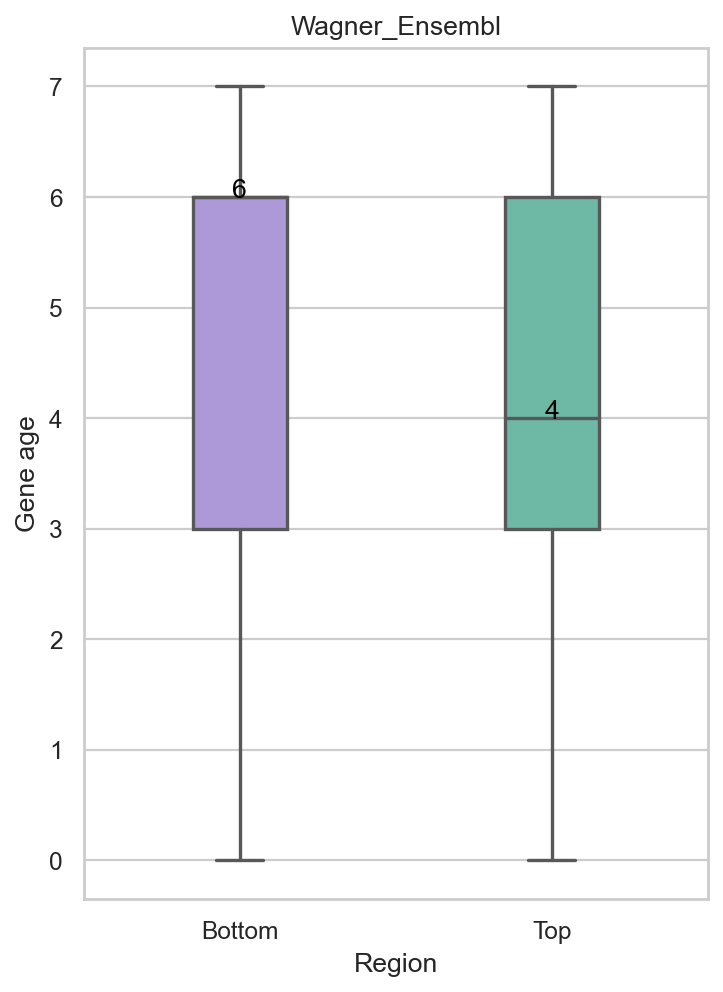

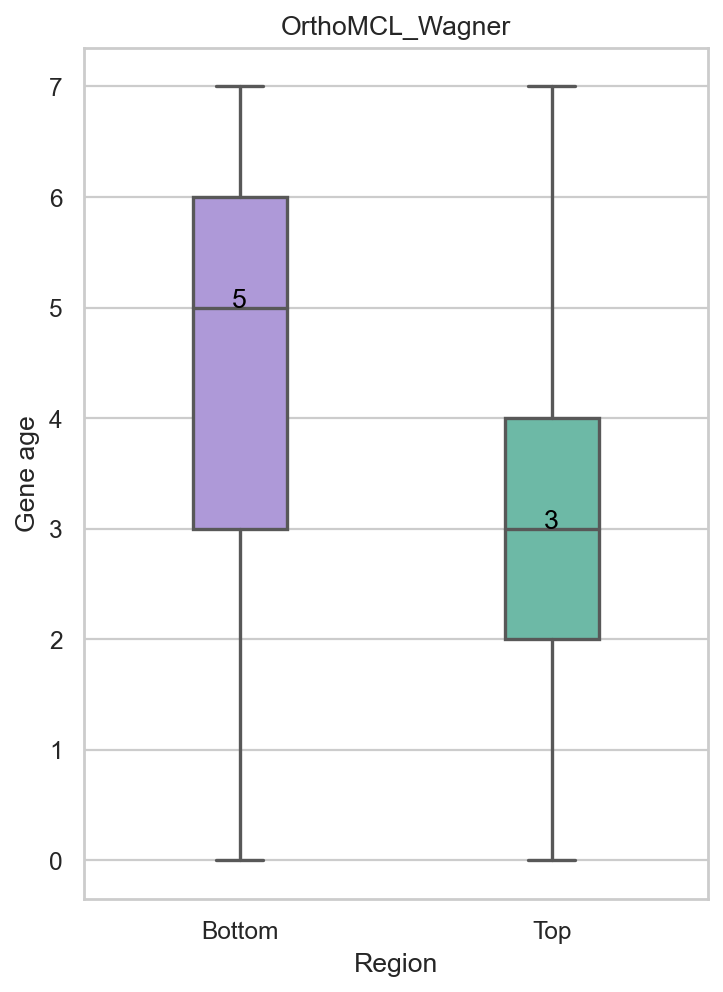

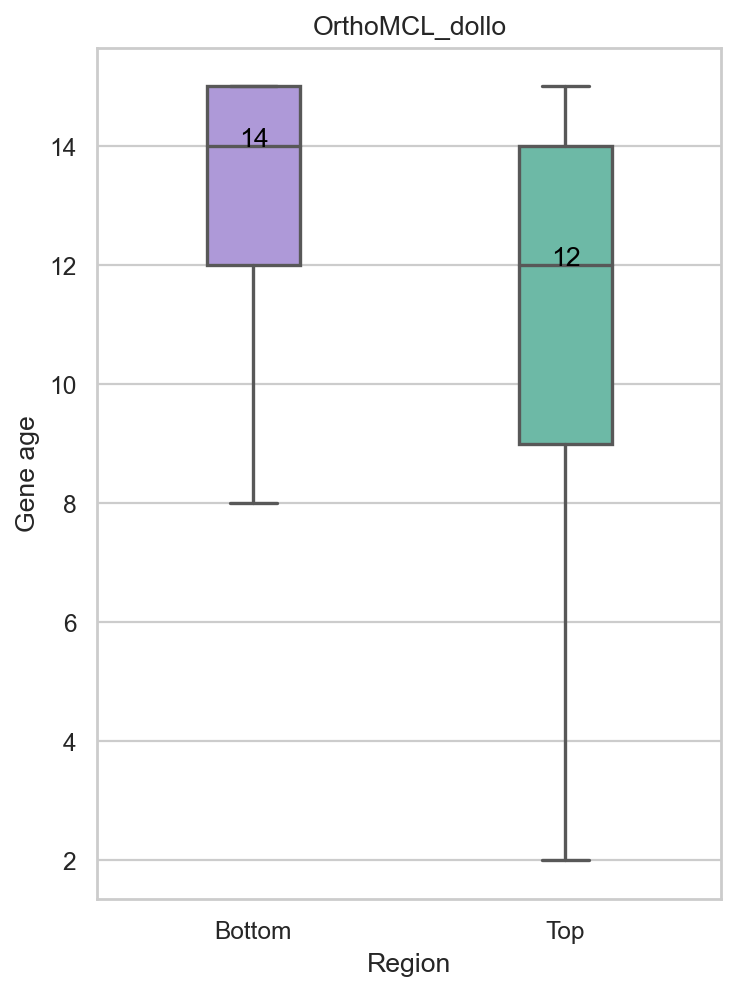

<Figure size 400x560 with 0 Axes>

In [40]:
import matplotlib.pyplot as plt
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

my_pal = {"Top": "#60c6ac", "Bottom": "#ab8ee3"} 

sns.set(rc={'figure.figsize':(5,7)})
sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})
sns.set_style("whitegrid")
              
# Define the columns and corresponding filenames
columns = [ 'Wagner_Ensembl', 'OrthoMCL_Wagner', 'OrthoMCL_dollo',
          ]
filenames = ['Wagner_Ensembl_byDE.pdf', 'OrthoMCL_Wagner_byDE.pdf','OrthoMCL_dollo_byDE.pdf', ]

# Iterate over columns and filenames
for column, filename in zip(columns, filenames):
    # Create the boxplot
    boxplot = sns.boxplot(data=human_de[[column, 'Status']].dropna(),
                          x='Status',
                          y=column,
                          order=["Bottom", "Top"],
                          showfliers=False,
                          palette=my_pal,
                          width=0.3)
    
    # Calculate medians
    medians = human_de.groupby('Status')[column].median()
    
    # Add medians to the plot
    for i, median in enumerate(medians):
        boxplot.text(i, median, f'{median:.0f}', horizontalalignment='center', color='black')
    
    # Set labels and title
    boxplot.set(title=column, ylabel='Gene age', xlabel='Region')
    
    plt.figure()
    # Save the plot
    plt.savefig(filename, bbox_inches='tight', transparent=True, format="pdf")
    
    # Clear the figure for the next iteration
    plt.clf()

### By villi scoring genes  

- By the 5 Clusters' genes used as the base for the previous scores (https://doi.org/10.1016/j.cell.2018.08.063)

In [42]:
zonation_genes = pd.read_csv('zonation_score_genes.csv',index_col=0)
zonation_genes= zonation_genes[[col for col in zonation_genes.columns if col.endswith('Human')]]
villi_clusters = zonation_genes.melt()
villi_clusters['variable'] = villi_clusters['variable'].str[:-6]

villi_clusters['Wagner_Ensembl'] = villi_clusters['value'].map(wagner).astype('float')
villi_clusters['OrthoMCL_dollo'] = villi_clusters['value'].map(OrthoMCL_dict).astype('float')
villi_clusters['OrthoMCL_Wagner'] = villi_clusters['value'].map(OrthoMCL2_dict).astype('float')

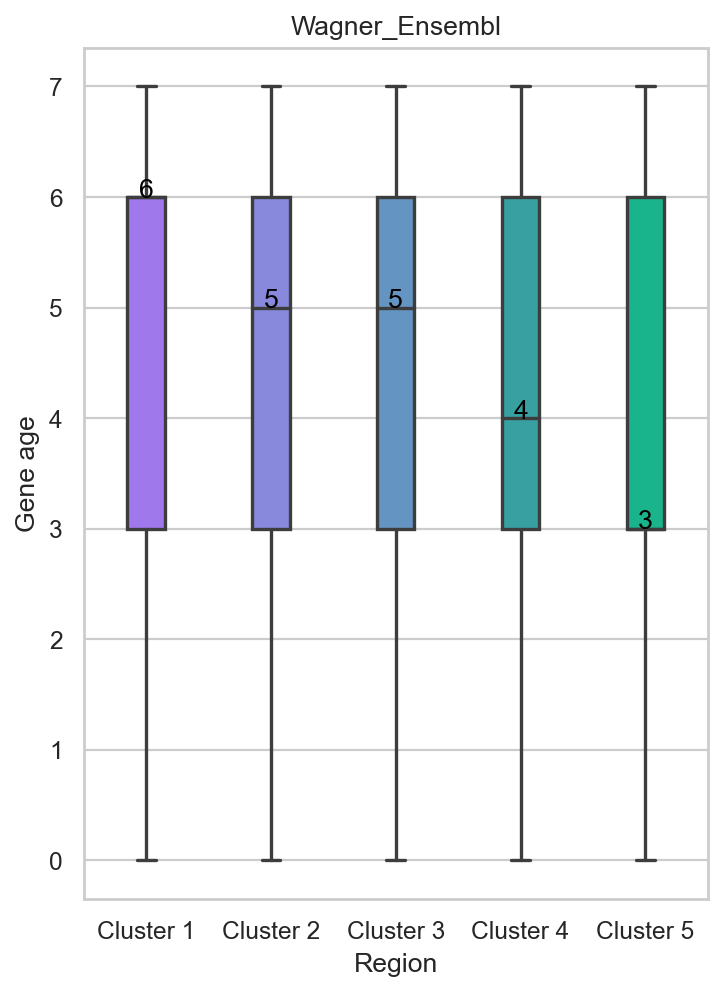

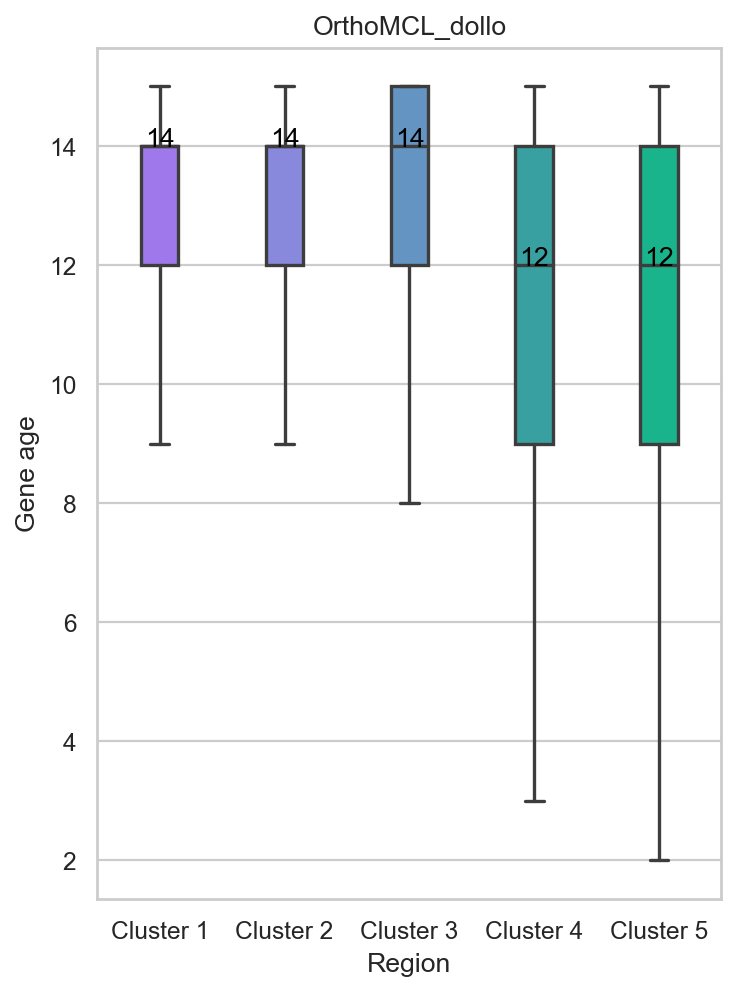

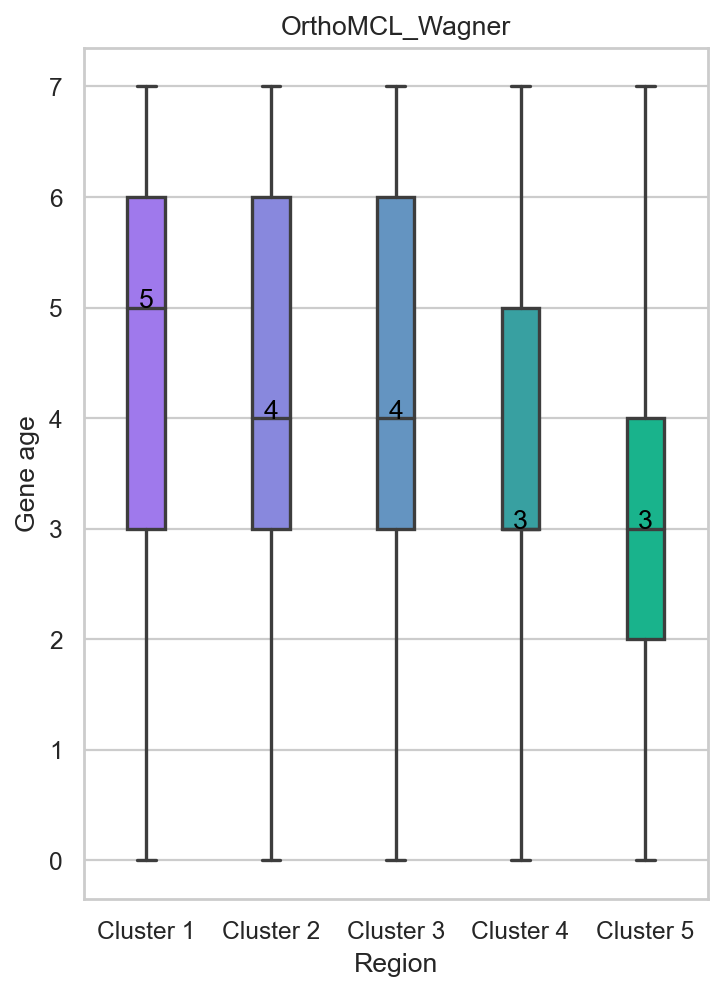

<Figure size 400x560 with 0 Axes>

In [43]:
sns.set(rc={'figure.figsize':(5,7)})
sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})
sns.set_style("whitegrid")
              
import matplotlib.pyplot as plt
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

scores_pal = {'Cluster 1':'#9966FF','Cluster 2':'#7a7aeb','Cluster 3':'#5494d1','Cluster 4':'#26b2b2','Cluster 5':'#00CC99'}

for age in ['Wagner_Ensembl','OrthoMCL_dollo','OrthoMCL_Wagner']:
    boxplot = sns.boxplot(data=villi_clusters[[age,'variable']].dropna(),
                          x="variable",
                          y=age,
                          order=["Cluster 1", "Cluster 2", "Cluster 3", "Cluster 4", "Cluster 5"],
                          showfliers = False,
                          width=0.3,
                          palette=scores_pal)
    # Calculate medians
    medians = villi_clusters.dropna().groupby('variable')[age].median()
    
    # Add medians to the plot
    for i, median in enumerate(medians):
        boxplot.text(i, median, f'{median:.0f}', horizontalalignment='center', color='black')
    # Set labels and title
    
    boxplot.set(title=age, ylabel='Gene age', xlabel='Region')
    # Save the plot
    plt.savefig(age+"by_cluster.pdf",bbox_inches='tight', transparent=True, format="pdf")
    
    plt.figure()

    
    # Clear the figure for the next iteration
    plt.clf()

## Conservation of top and bottom villi expression

### Box plots 

##### Gmatch - Unbiased pairing

- A tool for avoiding bias
- Analysis based on top 250 genes (lowest Q value)
- These genes are all expressed in over 20% of the cells (observed after filtration)
- Gmatch returns genes with an epsilon of -logQval of 5 at most 

In [48]:
import row_matchers as row_matchers

In [56]:
de_h = de.sort_values(by='Top_villi_pvals_adj_human').head(250).copy()
de_h = de_h[['status_human','minus_logQval_human']]

In [57]:
# Extracting genes - subset of either top villi or bottom villi genes
top_subset_human,bottom_subset_human = row_matchers.one_to_one_matches(de_h[de_h.status_human=='top'],de_h[de_h.status_human=='bottom'],'minus_logQval_human',5)

In [78]:
top_list =list(top_subset_human.index)
bottom_list =list(bottom_subset_human.index)
gmatch_genes = top_list +bottom_list

In [64]:
de_gmatch = de.loc[gmatch_genes]

##### Checking for bias

<Figure size 400x560 with 0 Axes>

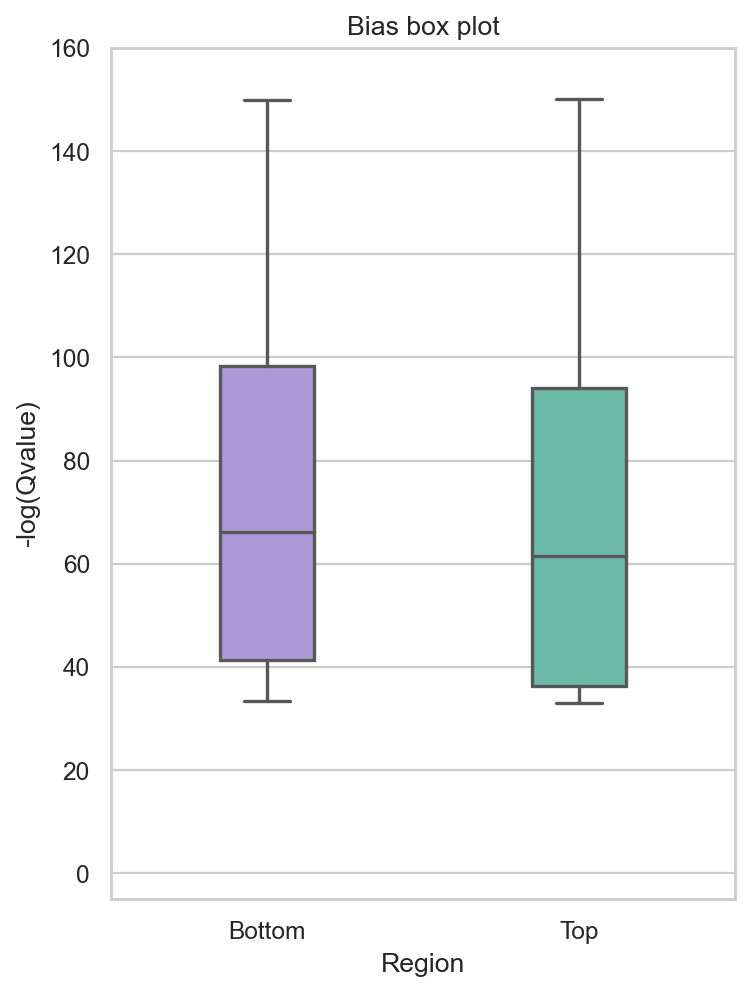

<Figure size 400x560 with 0 Axes>

In [68]:
import matplotlib.pyplot as plt
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
de_gmatch.replace({'bottom':'Bottom','top':'Top'},inplace=True)

my_pal = {"Top": "#60c6ac", "Bottom": "#ab8ee3"} 
sns.set(rc={'figure.figsize':(5,7)})
sns.set(rc={'axes.facecolor':'#F9F9FC', 'figure.facecolor':'white'})
sns.set_style("whitegrid")

boxplots = sns.boxplot(data=de_gmatch[de_gmatch.index.isin(gmatch_genes)][['minus_logQval_human','status_human']], x="status_human", y='minus_logQval_human', order=["Bottom", "Top"],showfliers = False,palette=my_pal,width=0.3, ).set(title="Bias box plot",ylabel='-log(Qvalue)',xlabel='Region')
plt.ylim(-5, 160)

plt.savefig("Bias_box_plot.pdf",bbox_inches='tight')
plt.figure()

##### Conserversion 

<Figure size 400x560 with 0 Axes>

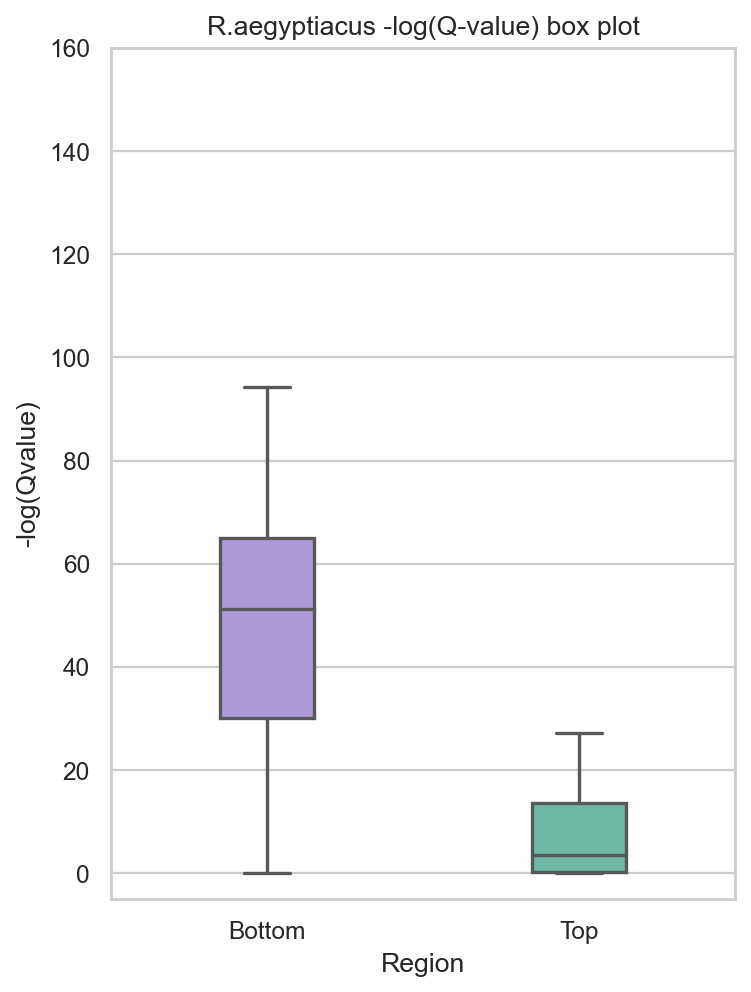

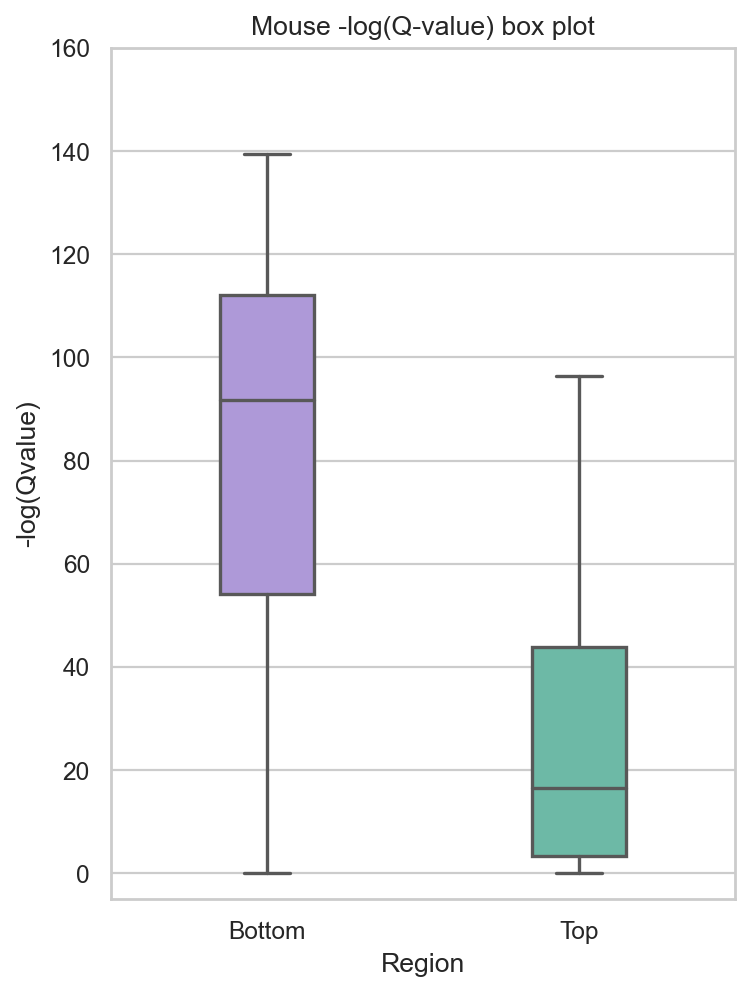

<Figure size 400x560 with 0 Axes>

In [74]:
boxplots = sns.boxplot(data=de_gmatch[de_gmatch.index.isin(gmatch_genes)][['minus_logQval_bat','status_human']], x="status_human", y='minus_logQval_bat', order=["Bottom", "Top"],showfliers = False,palette=my_pal,width=0.3, ).set(title="R.aegyptiacus -log(Q-value) box plot",ylabel='-log(Qvalue)',xlabel='Region')
plt.ylim(-5, 160)
plt.savefig("Bat_conservation_box_plot.pdf",bbox_inches='tight')

plt.figure()

boxplots = sns.boxplot(data=de_gmatch[de_gmatch.index.isin(gmatch_genes)][['minus_logQval_mouse','status_human']], x="status_human", y='minus_logQval_mouse', order=["Bottom", "Top"],showfliers = False,palette=my_pal,width=0.3, ).set(title="Mouse -log(Q-value) box plot",ylabel='-log(Qvalue)',xlabel='Region')
plt.ylim(-5, 160)
plt.savefig("Mouse_conservation_box_plot.pdf",bbox_inches='tight')

plt.figure()

###### STATS - Conservation

In [80]:
# Bias
bias_top = list(de_gmatch[de_gmatch.index.isin(top_list)].minus_logQval_human.values)
bias_bottom = list(de_gmatch[de_gmatch.index.isin(bottom_list)].minus_logQval_human.values)
# Bat
bat_top = list(de_gmatch[de_gmatch.index.isin(top_list)].minus_logQval_bat.values)
bat_bottom = list(de_gmatch[de_gmatch.index.isin(bottom_list)].minus_logQval_bat.values)
# Mouse
mouse_top = list(de_gmatch[de_gmatch.index.isin(top_list)].minus_logQval_mouse.values)
mouse_bottom = list(de_gmatch[de_gmatch.index.isin(bottom_list)].minus_logQval_mouse.values)

In [81]:
from scipy.stats import mannwhitneyu

d={}
#Bias
d["Bias top"] = bias_top
d["Bias bottom"] = bias_bottom

#Conservation
d["Bat top"] = bat_top
d["Bat bottom"] = bat_bottom

d["Mouse top"] = mouse_top
d["Mouse bottom"] = mouse_bottom


#Bias
statistic, pvalue1 = mannwhitneyu(d['Bias top'], d['Bias bottom'], alternative="two-sided")
print('Bias\t', pvalue1)

#Conservation
statistic, pvalue1 = mannwhitneyu(d['Bat top'], d['Bat bottom'], alternative="less")
print('\nR.aegyptiacus\t', pvalue1)

statistic, pvalue1 = mannwhitneyu(d['Mouse top'], d['Mouse bottom'], alternative="less")
print('\nMouse\t', pvalue1,)

Bias	 0.2757925015765198

R.aegyptiacus	 1.2294157933645057e-13

Mouse	 2.56906877260437e-11


### Volcano plots

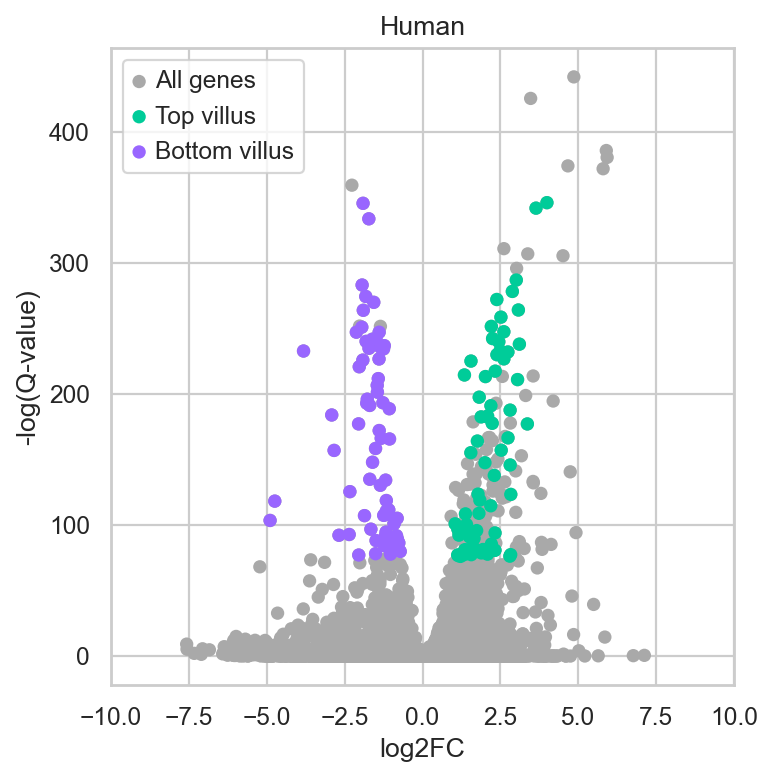

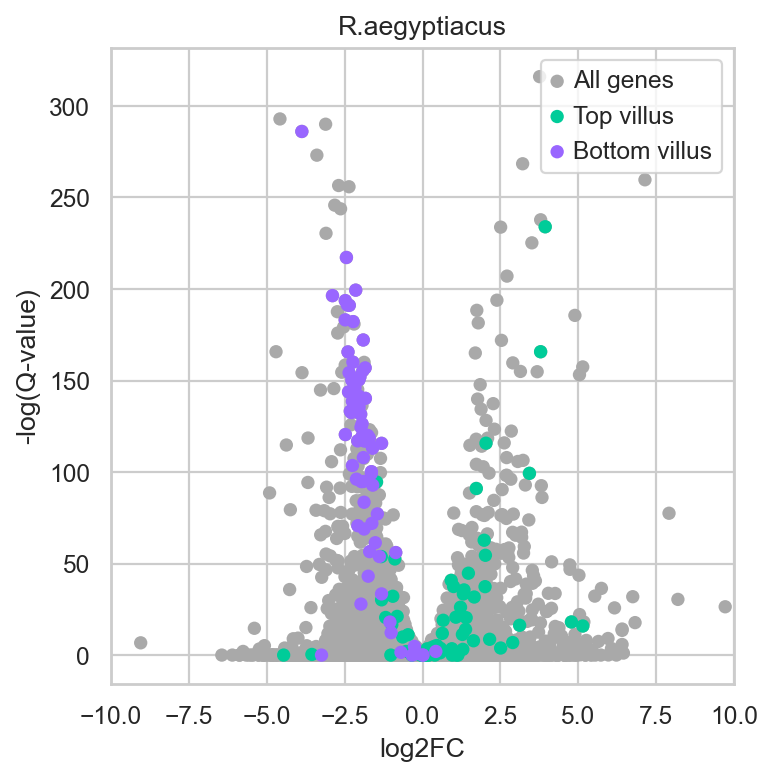

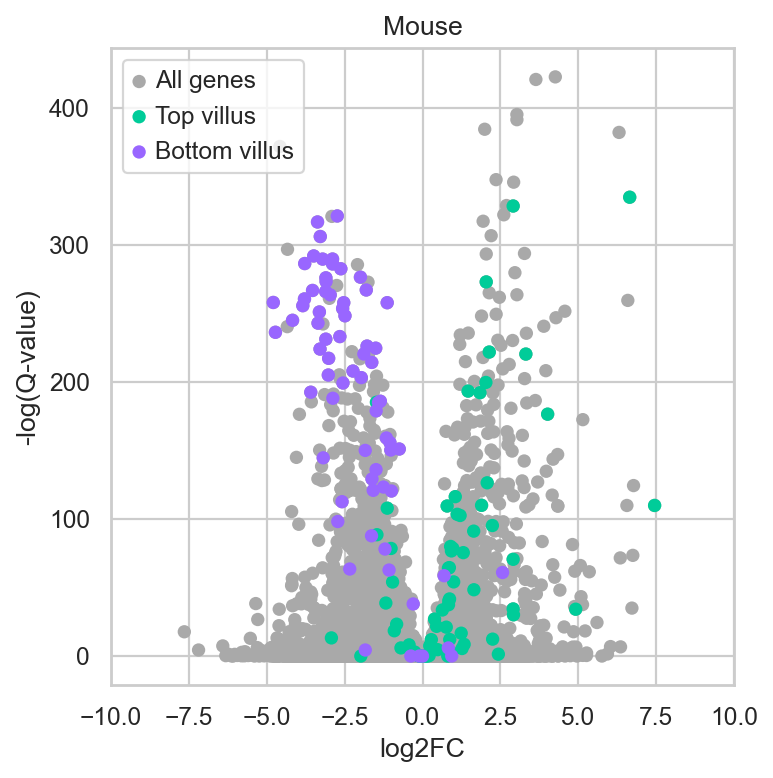

In [85]:
species_data = [('Human', 'Top_villi_logfoldchanges_human', 'minus_logQval_human', 'Top_villi_pvals_adj_human'),
    ('R.aegyptiacus', 'Top_villi_logfoldchanges_bat', 'minus_logQval_bat', 'Top_villi_pvals_adj_bat'),
    ('Mouse', 'Top_villi_logfoldchanges_mouse', 'minus_logQval_mouse', 'Top_villi_pvals_adj_mouse') ]

for species_name, logFC_col, logQ_col, pval_adj_col in species_data:
    species = de[[logFC_col, logQ_col, pval_adj_col]]

    lowest_non_zero = species.loc[species[pval_adj_col] != 0, pval_adj_col].min()
    species.loc[species[pval_adj_col] == 0, pval_adj_col] = lowest_non_zero
    species[logQ_col] = -np.log(species[pval_adj_col])

    species.rename(columns={logFC_col: 'log2FC', logQ_col: '-log(Q-value)'}, inplace=True)

    plt.figure(figsize=(5, 5))

    sns.scatterplot(data=species, x='log2FC', y='-log(Q-value)', color='#A9A9A9', label='All genes', edgecolor='none')
    top_df = species.loc[top_list]
    sns.scatterplot(data=top_df, x='log2FC', y='-log(Q-value)', color='#00CC99', label='Top villus', edgecolor='none')
    bottom_df = species.loc[bottom_list]
    sns.scatterplot(data=bottom_df, x='log2FC', y='-log(Q-value)', color='#9966FF', label='Bottom villus', edgecolor='none')

    plt.xlim(-10, 10)
    plt.xlabel('log2FC')
    plt.ylabel('-log(Q-value)')
    plt.title(species_name)
    plt.legend()
    plt.tight_layout()
    plt.savefig(species_name + '_divergence_volcano' + ".pdf", bbox_inches='tight')
    plt.show()

# Gprofiler

- DE for top villi genes in human and mouse vs bat.
- Only genes that are expressed in over 5% of the cells are included in the analysis to avoid noise of lowly expressed genes and noise.
- Genes sorted by max delta and qval filtered by a threshold of 0.01 for the top villi species
- Genes were filtered for logFC<0.5 for the other species and min deltaFC >0 for the top villi species 
- A list of 100 genes was the input for the gprofiler algoritm

In [86]:
de_hm = de[(de.expression_bat.isin(['>5%','>20%']))&(de.expression_human.isin(['>5%','>20%']))&(de.expression_mouse.isin(['>5%','>20%']))].copy()
de_hm = de_hm[de_hm.max_qval_human_mouse<0.01]
de_hm = de_hm[(de_hm.status_human=='top')&(de_hm.status_mouse=='top')&(de_hm.min_delta_2>0)]
de_hm = de_hm[de_hm.Top_villi_logfoldchanges_bat<0.5]
de_hm.sort_values(by='max_delta_2',ascending=False,inplace=True)

# Gene expression along the villi axis

In [120]:
#Shared orthologs 

orthology = pd.read_excel("orthology.xlsx",sheet_name='1-1-1 orthologs',)

bat_egg_dict =dict(zip(orthology['bat gene name'],orthology.eggnog_name)) 
human_egg_dict =dict(zip(orthology['human gene id'],orthology.eggnog_name))
mouse_egg_dict =dict(zip(orthology['mouse gene id'],orthology.eggnog_name))

bat = sc.read("bat_gut.h5ad") 
bat = bat[bat.obs.inter_species_ann.isin(['Enterocyte','TA','Stem_cell'])]
bat_meta = pd.read_csv("bat_villi_metadata.csv",index_col=0)
bat.obs['villi_axis'] = 'Crypt'
bat.obs.update(bat_meta)

mouse = sc.read("mouse_SI.h5ad")
mouse = mouse[mouse.obs.inter_species_ann.isin(['Enterocyte','TA','Stem_cell'])]
mouse_meta = pd.read_csv("mouse_villi_metadata.csv",index_col=0)
mouse.obs['villi_axis'] = 'Crypt'
mouse.obs.update(mouse_meta)

human = human[human.obs.inter_species_ann.isin(['Enterocyte','TA','Stem_cell'])]
human_meta = pd.read_csv("human_villi_metadata.csv",index_col=0)
human.obs['villi_axis'] = 'Crypt'
human.obs.update(human_meta)

bat.var['Bat_Eggnog'] = bat.var.index.copy()
human.var['human_gene_name'] = human.var.index.copy()
mouse.var['mouse_gene_name'] = mouse.var.index.copy()

bat =  bat[:, bat.var["original_name"].isin(bat_egg_dict.keys())]
human =  human[:, human.var["gene_ids"].isin(human_egg_dict.keys())]
mouse =  mouse[:, mouse.var["Ensembl"].isin(mouse_egg_dict.keys())]

#Mutual gene names for all species
bat.var['eggnog_name'] = bat.var.original_name.map(bat_egg_dict).astype('category')
human.var['eggnog_name'] = human.var.gene_ids.map(human_egg_dict).astype('category') 
mouse.var['eggnog_name'] = mouse.var.Ensembl.map(mouse_egg_dict).astype('category') 

bat.var.set_index('eggnog_name',inplace=True)    
human.var.set_index('eggnog_name',inplace=True)    
mouse.var.set_index('eggnog_name',inplace=True)    

In [121]:
sc.pp.normalize_total(mouse, target_sum=10000)
sc.pp.log1p(mouse)

sc.pp.normalize_total(bat, target_sum=10000)
sc.pp.log1p(bat)

sc.pp.normalize_total(human, target_sum=10000)
sc.pp.log1p(human)

normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)


### Gene sets from gene ontology results

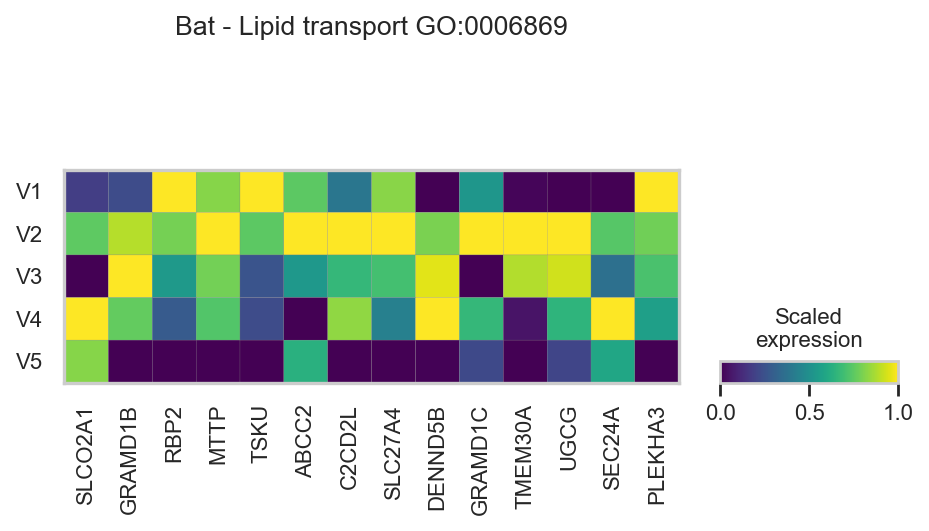

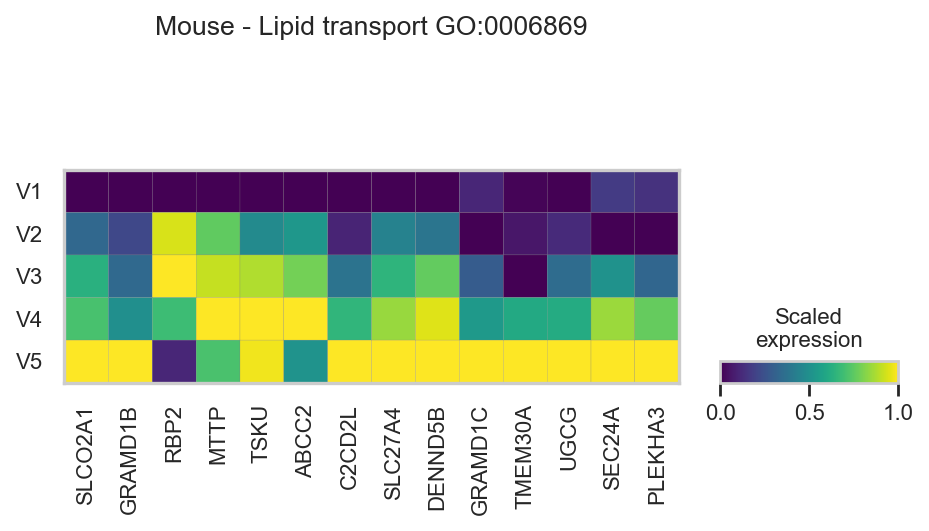

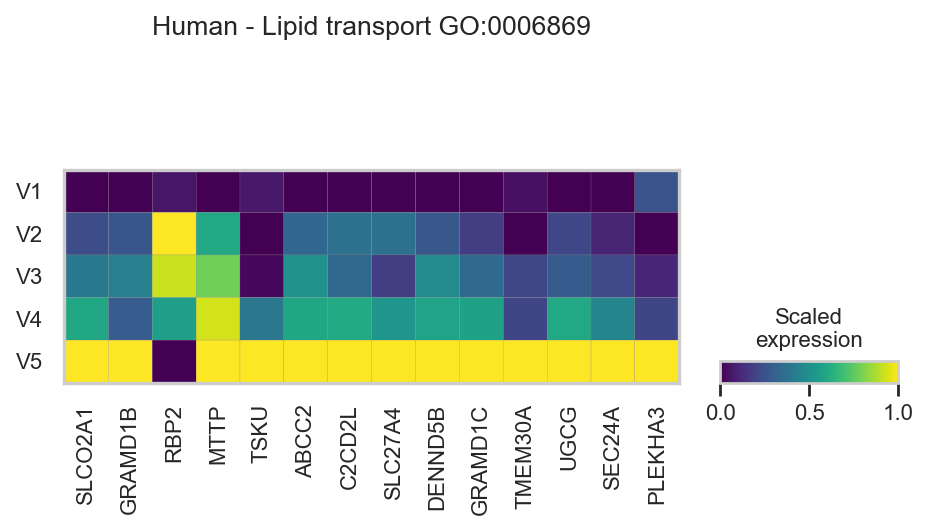

In [130]:
# Lipid transport GO:0006869 - Gene set from the gene ontology results

lipid_transport=['ENSG00000174640','ENSG00000023171','ENSG00000114113','ENSG00000138823','ENSG00000182704','ENSG00000023839','ENSG00000172375','ENSG00000167114','ENSG00000170456','ENSG00000178075','ENSG00000112697','ENSG00000148154','ENSG00000113615','ENSG00000116095']
lipid_transport = [human_egg_dict[i] for i in lipid_transport]

sc.pl.matrixplot(bat[bat.obs.villi_axis!='Crypt'],lipid_transport,groupby='villi_axis',title='Bat - Lipid transport GO:0006869',standard_scale='var',colorbar_title='Scaled\nexpression',save = 'bat_lipid_transport_scaled.pdf')
sc.pl.matrixplot(mouse[mouse.obs.villi_axis!='Crypt'],lipid_transport,groupby='villi_axis',title='Mouse - Lipid transport GO:0006869',standard_scale='var',colorbar_title='Scaled\nexpression',save = 'mouse_lipid_transport_scaled.pdf')
sc.pl.matrixplot(human[human.obs.villi_axis!='Crypt'],lipid_transport,groupby='villi_axis',title='Human - Lipid transport GO:0006869',standard_scale='var',colorbar_title='Scaled\nexpression',save = 'human_lipid_transport_scaled.pdf')

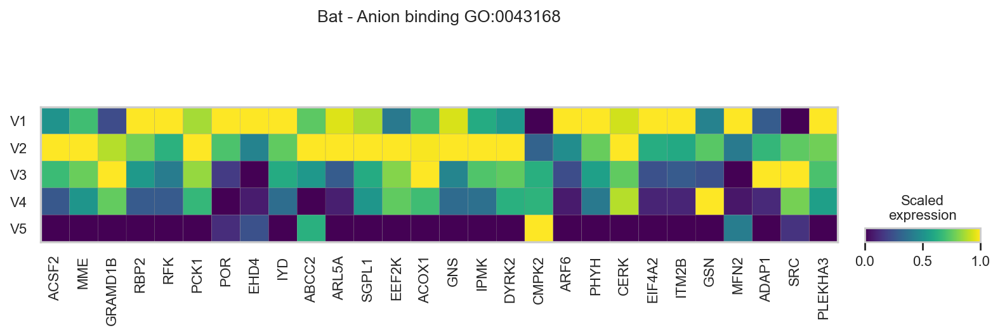

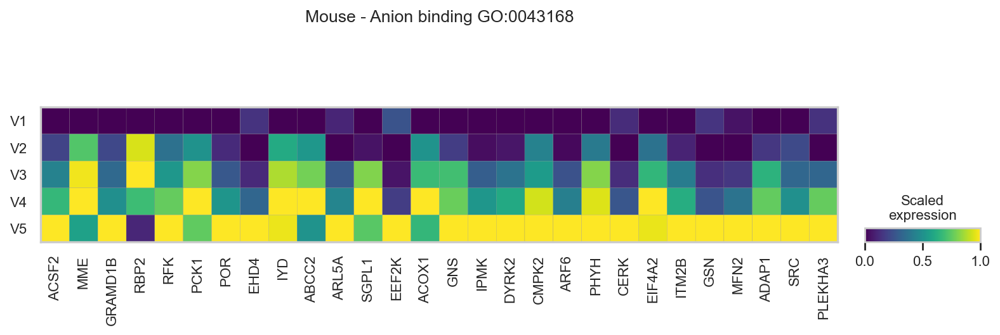

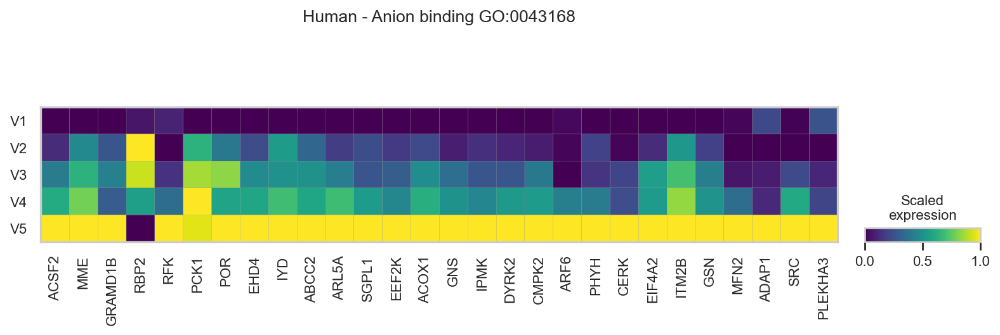

In [132]:
#GO:0043168 Gene set from the gene ontology results
anion_binding=['ENSG00000167107','ENSG00000196549','ENSG00000023171','ENSG00000114113','ENSG00000135002','ENSG00000124253','ENSG00000127948','ENSG00000103966','ENSG00000009765','ENSG00000023839','ENSG00000162980','ENSG00000166224','ENSG00000103319','ENSG00000161533','ENSG00000135677','ENSG00000151151','ENSG00000127334','ENSG00000134326','ENSG00000165527','ENSG00000107537','ENSG00000100422','ENSG00000156976','ENSG00000136156','ENSG00000148180','ENSG00000116688','ENSG00000105963','ENSG00000197122','ENSG00000116095']
anion_binding = [human_egg_dict[i] for i in anion_binding]

sc.pl.matrixplot(bat[bat.obs.villi_axis!='Crypt'],anion_binding,groupby='villi_axis',title='Bat - Anion binding GO:0043168',standard_scale='var',colorbar_title='Scaled\nexpression',save = 'bat_anion_binding_scaled.pdf')
sc.pl.matrixplot(mouse[mouse.obs.villi_axis!='Crypt'],anion_binding,groupby='villi_axis',title='Mouse - Anion binding GO:0043168',standard_scale='var',colorbar_title='Scaled\nexpression',save = 'mouse_anion_binding_scaled.pdf')
sc.pl.matrixplot(human[human.obs.villi_axis!='Crypt'],anion_binding,groupby='villi_axis',title='Human - Anion binding GO:0043168',standard_scale='var',colorbar_title='Scaled\nexpression',save = 'human_anion_binding_scaled.pdf')

### Functional absorption genes 

In [133]:
# All genes are expressed in over 10% In at least one zone (V1-V5) in each species 
# Origin - Wang, Y. et al. Single-cell transcriptome analysis reveals differential nutrient absorption functions in human intestine. J. Exp. Med. 217, (2020)

sugar_genes  = ['SLC5A1','SLC2A2','SLC50A1']
amico_acid_genes =['SLC7A9','SLC6A19','SLC3A1','SLC25A13','SLC7A7','SLC1A1','SLC6A6','SLC38A2','SLC25A39',]
vitamins_genes = ['RBP2','TCN2','SLC23A1','BTD']
vitamins_genes.reverse()
nucleotide_genes = ['SLC25A36','NT5E','SLC35D1','SLC35A3','SLC35A1','SLC35B3','SLC17A5']
Bile_salt_genes=['SLC51B']
water_genes=['AQP11']
organic_solute_genes=['SLC16A5','SLC51B','SLC44A1']
inorganic_solute_genes=['SLC20A1','SLC9A3R1','SLC26A2','SLC25A3','SLC4A4','SLC4A7','CFTR']
Metal_ion_genes = ['SLC30A9','SLC39A5','SLC31A1','SLC30A7','SLC30A5']
Metal_ion_genes.reverse()

absorption = {'Sugar':sugar_genes,'Amino acid':amico_acid_genes,'Vitamins':vitamins_genes,'Water':water_genes,'Bile salt':Bile_salt_genes,'Metal ion':Metal_ion_genes,'Organic solute':organic_solute_genes,'Inorganic solute':inorganic_solute_genes,'Nucleotide':nucleotide_genes}

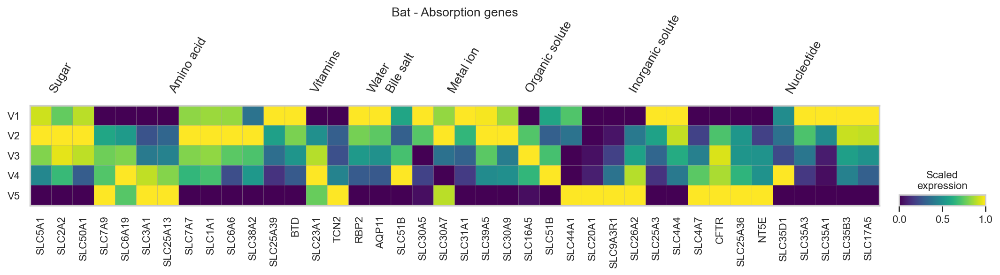

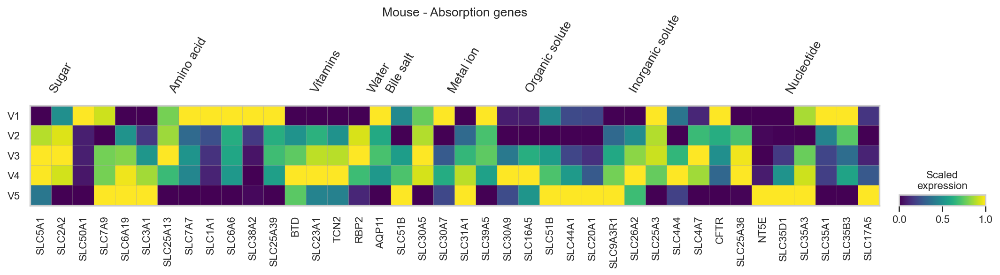

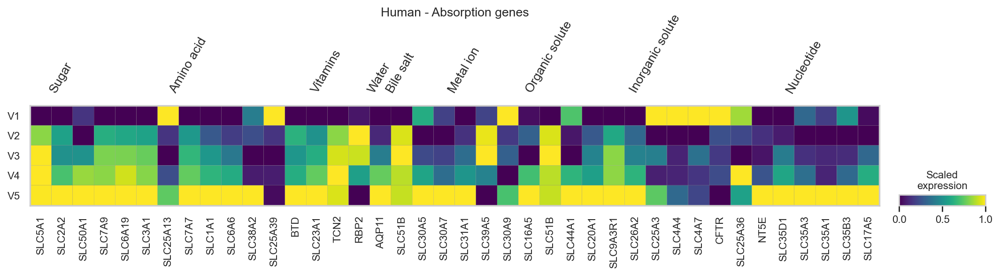

In [126]:
sc.pl.matrixplot(bat[bat.obs.villi_axis!='Crypt'],absorption,groupby='villi_axis',standard_scale='var',var_group_rotation=60,title = 'Bat - Absorption genes\n\n',colorbar_title='Scaled\nexpression',save='absorption_genes_from_paper_nolipids_bat.pdf')
sc.pl.matrixplot(mouse[mouse.obs.villi_axis!='Crypt'],absorption,groupby='villi_axis',standard_scale='var',var_group_rotation=60,title = 'Mouse - Absorption genes\n\n',colorbar_title='Scaled\nexpression',save='absorption_genes_from_paper_nolipids_mouse.pdf')
sc.pl.matrixplot(human[human.obs.villi_axis!='Crypt'],absorption,groupby='villi_axis',standard_scale='var',var_group_rotation=60,title = 'Human - Absorption genes\n\n',colorbar_title='Scaled\nexpression',save='absorption_genes_from_paper_nolipids_human.pdf')

### Complement system genes 

> After observing complement system genes in Enterocytes, TA and stem cells DE analysis between species

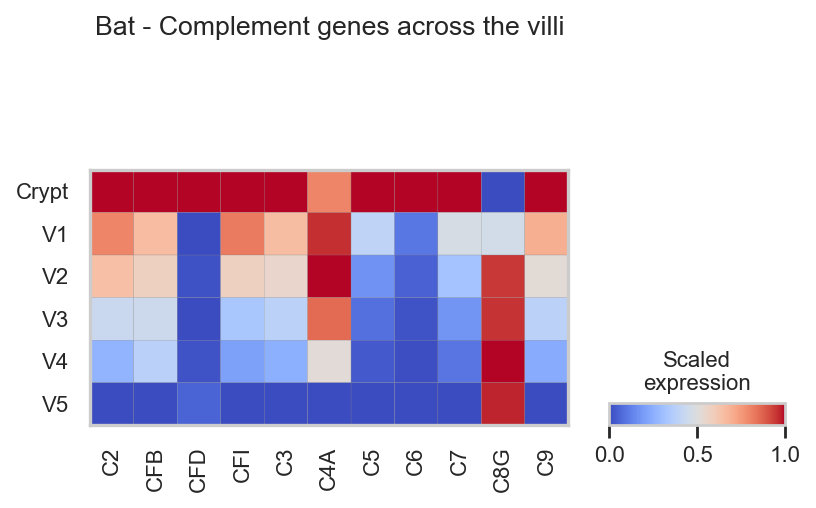

In [127]:
complement_bat = ['C2','CFB','CFD','CFI','C3','C4A','C5','C6','C7','C8G','C9']
sc.pl.matrixplot(bat,complement_bat,groupby='villi_axis',cmap='coolwarm',standard_scale='var',var_group_rotation=0,title = 'Bat - Complement genes across the villi',save='Complement_genes_across_the_villi_magma.pdf',colorbar_title='Scaled\nexpression')

# ScVelo

In [161]:
zonation_genes = pd.read_csv('zonation_score_genes.csv',index_col=0)
zonation_genes.fillna('null',inplace=True)
b= zonation_genes[[col for col in zonation_genes.columns if col.endswith('Bat')]]
m= zonation_genes[[col for col in zonation_genes.columns if col.endswith('Mouse')]]

## Bat

batvelo - Raw bat scvelo data of enterocytes, after concatenaton of loom files and adding top-bottom metadata from the previous analysis (scores and affiliation). 

In [148]:
scv.set_figure_params('scvelo')  

In [149]:
scores = ['Cluster 1_score','Cluster 2_score','Cluster 3_score','Cluster 4_score','Cluster 5_score']

In [150]:
batvelo = sc.read('bat_scvelo_enterocytes.h5ad') 

In [151]:
batvelo.obs = bat_meta

In [152]:
bat_clusters={}
for cluster in b.columns:
    bat_clusters[cluster[:-4]] = [i for i in b[cluster].to_list() if i!='null']

In [153]:
scv.pp.filter_and_normalize(batvelo, min_shared_counts=20, n_top_genes=24328) #all 
scv.pp.moments(batvelo, n_pcs=30, n_neighbors=30)

Filtered out 14683 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.
computing PCA
    with n_comps=30
    finished (0:00:04)
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:07) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [154]:
scv.tl.velocity(batvelo,)
scv.tl.velocity_graph(batvelo)

computing velocities
    finished (0:00:10) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)


  0%|          | 0/14373 [00:00<?, ?cells/s]

    finished (0:01:18) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:03) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
figure cannot be saved as pdf, using png instead.
saving figure to file ./figures/scvelo_batvelo_scores_pca.png


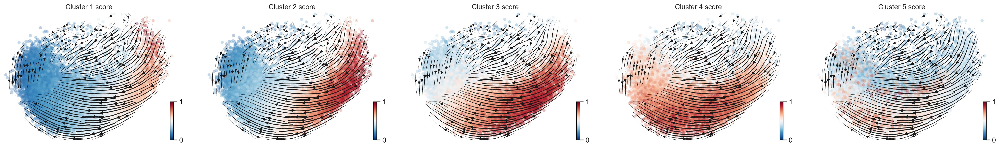

figure cannot be saved as pdf, using png instead.
saving figure to file ./figures/scvelo_batvelo_villi_axis_pca.png


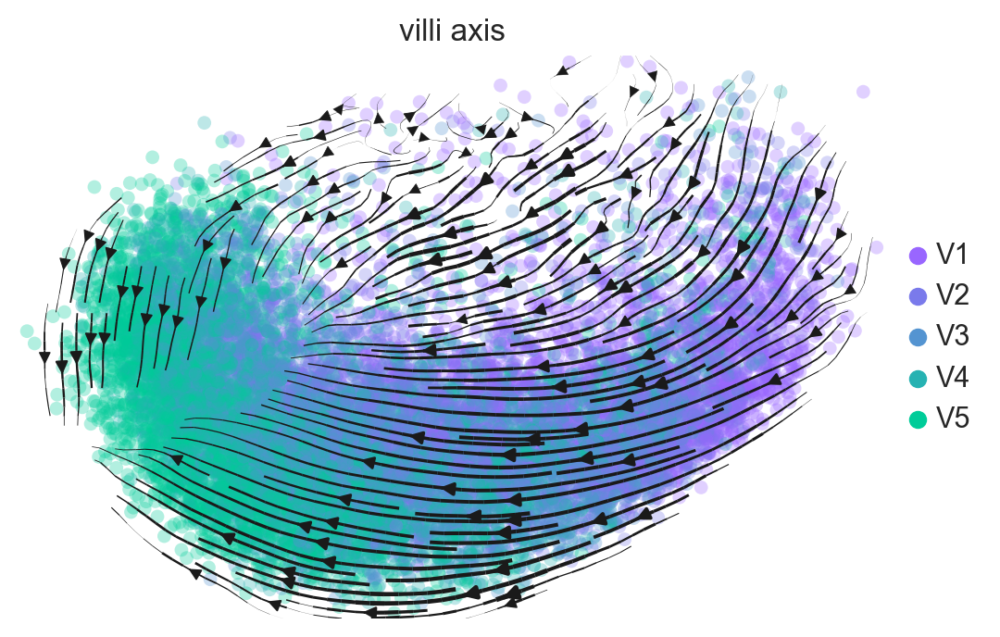

In [155]:
scores_pal = {'V1':'#9966FF','V2':'#7a7aeb','V3':'#5494d1','V4':'#26b2b2','V5':'#00CC99'}

scv.pl.velocity_embedding_stream(batvelo, basis='pca',color=scores,cmap='RdBu_r',save = 'batvelo_scores_pca.pdf')
scv.pl.velocity_embedding_stream(batvelo, basis='pca',legend_loc='right',color='villi_axis',save ='batvelo_villi_axis_pca.pdf',palette=scores_pal)

In [63]:
scv.tl.recover_dynamics(batvelo)
scv.tl.velocity(batvelo, mode='dynamical')
scv.tl.velocity_graph(batvelo)

recovering dynamics (using 1/12 cores)


  0%|          | 0/1546 [00:00<?, ?gene/s]

    finished (0:32:53) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:17) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)


  0%|          | 0/14373 [00:00<?, ?cells/s]

    finished (0:00:41) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:01) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:05) --> added 
    'latent_time', shared time (adata.obs)


saving figure to file ./figures/scvelo_heatmap_all_enterocytes_Cluster_1velo_v1tov5_nogene_labels.png


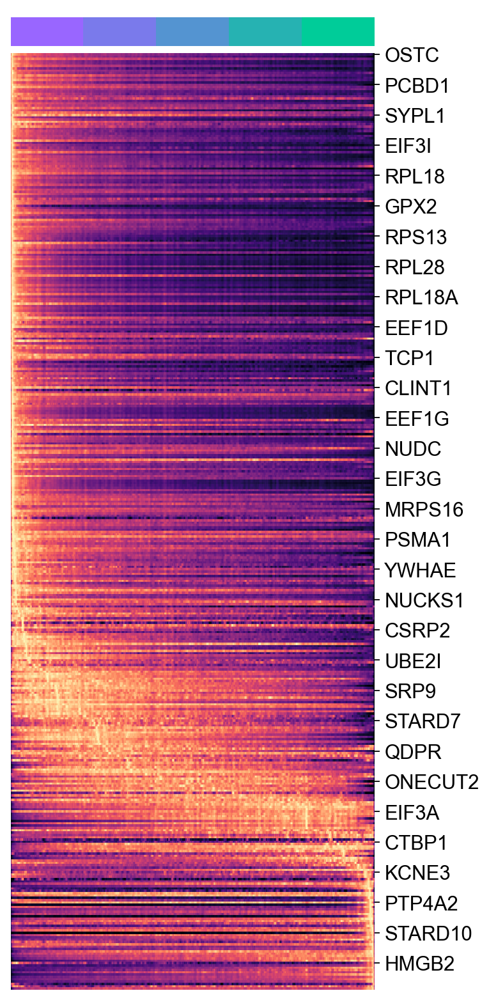

saving figure to file ./figures/scvelo_heatmap_all_enterocytes_Cluster_2velo_v1tov5_nogene_labels.png


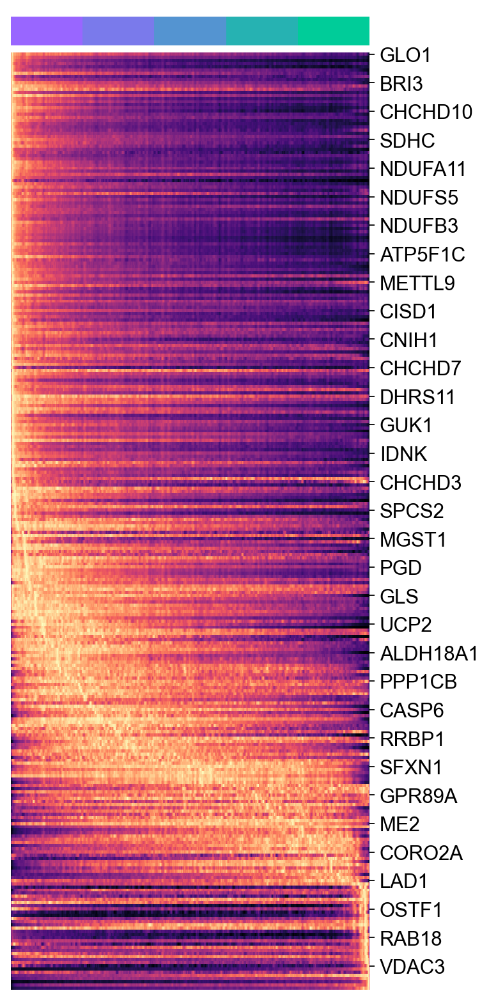

saving figure to file ./figures/scvelo_heatmap_all_enterocytes_Cluster_3velo_v1tov5_nogene_labels.png


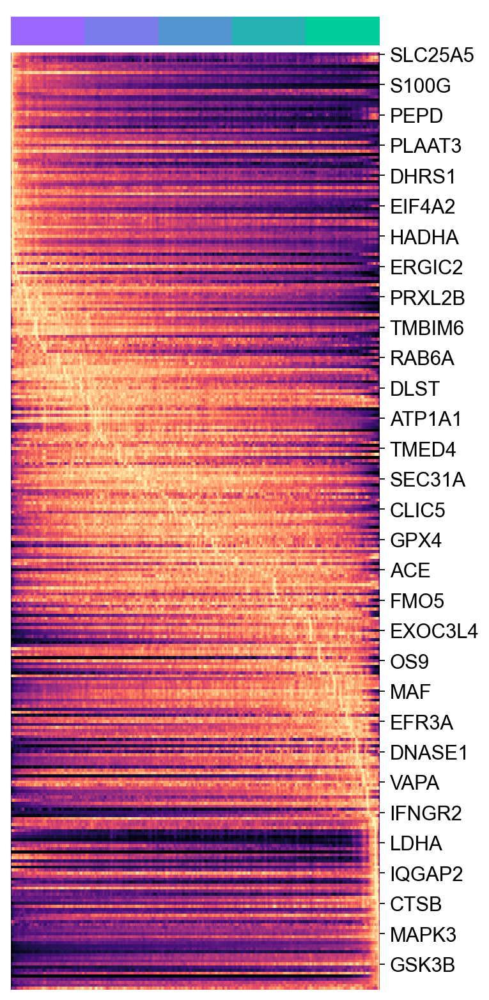

saving figure to file ./figures/scvelo_heatmap_all_enterocytes_Cluster_4velo_v1tov5_nogene_labels.png


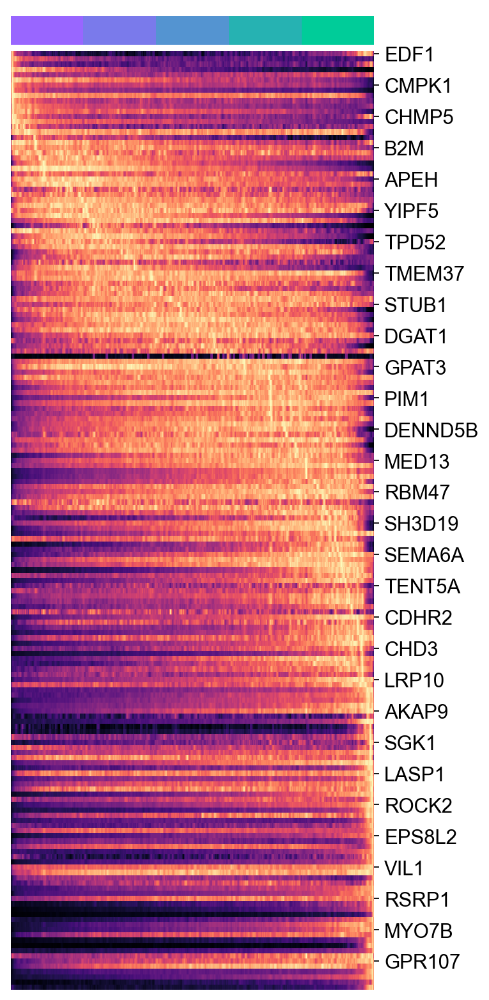

saving figure to file ./figures/scvelo_heatmap_all_enterocytes_Cluster_5velo_v1tov5_nogene_labels.png


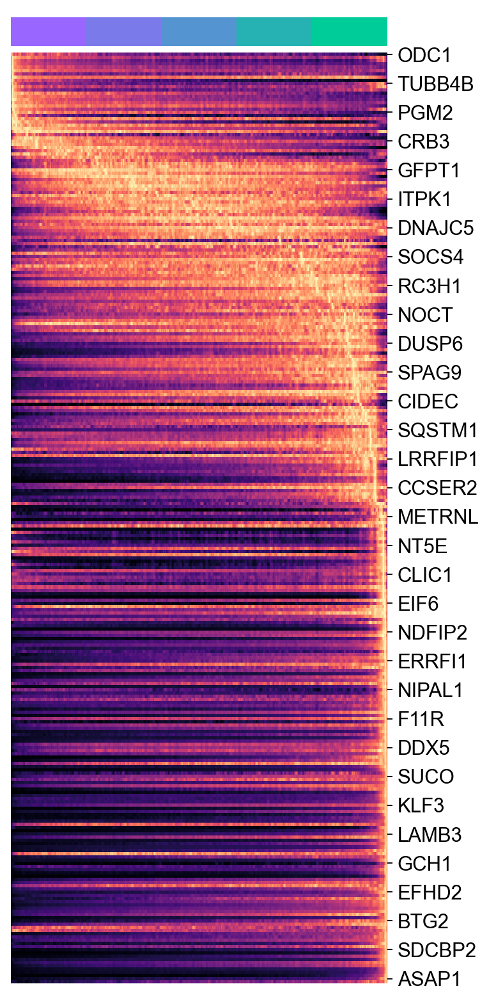

In [26]:
import matplotlib.pyplot as plt
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

scv.pl.heatmap(batvelo, var_names=bat_clusters['Cluster 1'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[5,10],save='all_enterocytes_Cluster_1velo_v1tov5_nogene_labels.png')
scv.pl.heatmap(batvelo, var_names=bat_clusters['Cluster 2'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[5,10],save='all_enterocytes_Cluster_2velo_v1tov5_nogene_labels.png',)
scv.pl.heatmap(batvelo, var_names=bat_clusters['Cluster 3'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[5,10],save='all_enterocytes_Cluster_3velo_v1tov5_nogene_labels.png')
scv.pl.heatmap(batvelo, var_names=bat_clusters['Cluster 4'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[5,10],save='all_enterocytes_Cluster_4velo_v1tov5_nogene_labels.png')
scv.pl.heatmap(batvelo, var_names=bat_clusters['Cluster 5'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[5,10],save='all_enterocytes_Cluster_5velo_v1tov5_nogene_labels.png')

## Mouse

In [167]:
mldata = sc.read("mouse_concatenated_loom.h5ad")
mldata = mldata[mldata.obs.index.isin(mouse_meta.index)]
mldata.obs = mouse_meta.copy()

In [165]:
mouse_clusters={}
for cluster in m.columns:
    mouse_clusters[cluster[:-6]] = [i for i in m[cluster].to_list() if i!='null']

In [168]:
scv.pp.filter_and_normalize(mldata, min_shared_counts=20, n_top_genes=53801) #all
scv.pp.moments(mldata, n_pcs=30, n_neighbors=30)

Filtered out 45513 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.
computing PCA
    with n_comps=30
    finished (0:00:04)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:04) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [169]:
scv.tl.velocity(mldata)
scv.tl.velocity_graph(mldata)

computing velocities
    finished (0:00:05) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)


  0%|          | 0/8788 [00:00<?, ?cells/s]

    finished (0:00:40) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:01) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)
figure cannot be saved as pdf, using png instead.
saving figure to file ./figures/scvelo_mouse_scores_pca_no_legend.png


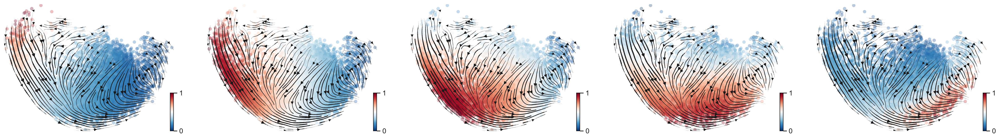

figure cannot be saved as pdf, using png instead.
saving figure to file ./figures/scvelo_mouse_villi_axis_pca_no_legend.png


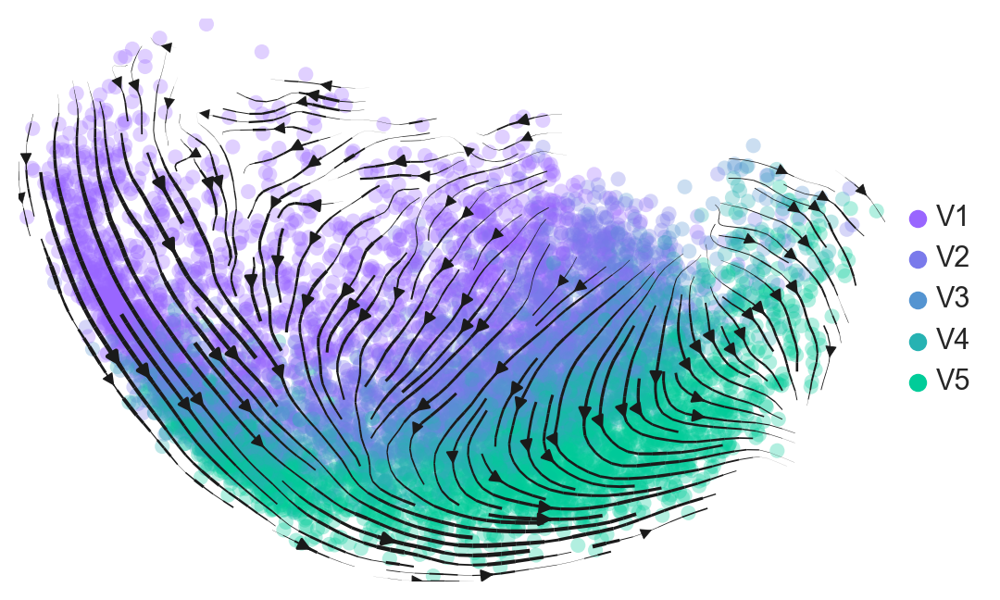

In [170]:
scores_pal = {'V1':'#9966FF','V2':'#7a7aeb','V3':'#5494d1','V4':'#26b2b2','V5':'#00CC99'}

scv.pl.velocity_embedding_stream(mldata, basis='pca',color=scores,cmap='RdBu_r',save = 'mouse_scores_pca_no_legend.pdf',title='',legend_loc=None)
scv.pl.velocity_embedding_stream(mldata, basis='pca',legend_loc='right',color='villi_axis',save ='mouse_villi_axis_pca_no_legend.pdf',palette=scores_pal,title='')

In [68]:
scv.tl.recover_dynamics(mldata)
scv.tl.velocity(mldata, mode='dynamical')
scv.tl.velocity_graph(mldata)

computing terminal states
    identified 7 regions of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
recovering dynamics (using 1/12 cores)


  0%|          | 0/961 [00:00<?, ?gene/s]

    finished (0:12:52) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:09) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/12 cores)


  0%|          | 0/8788 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing latent time using root_cells as prior
    finished (0:00:02) --> added 
    'latent_time', shared time (adata.obs)


saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_1velo_v1tov5.png


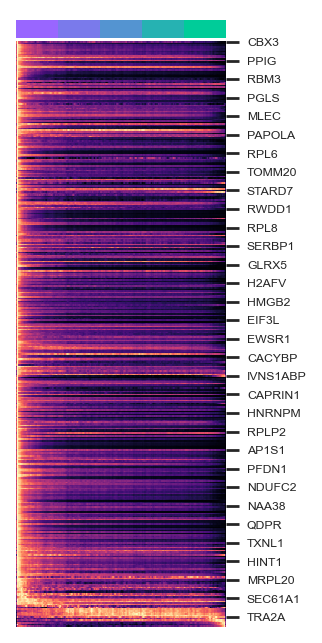

saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_2velo_v1tov5.png


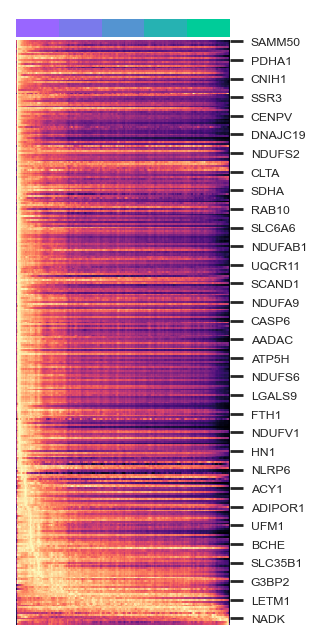

saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_3velo_v1tov5.png


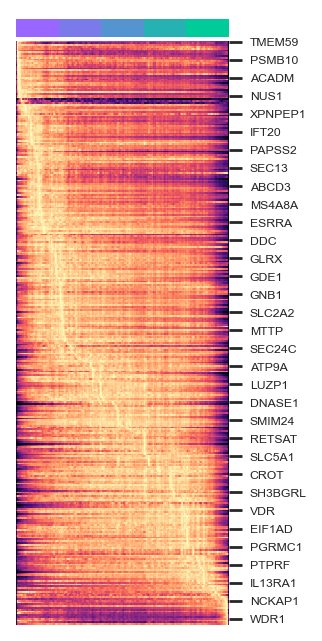

saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_4velo_v1tov5.png


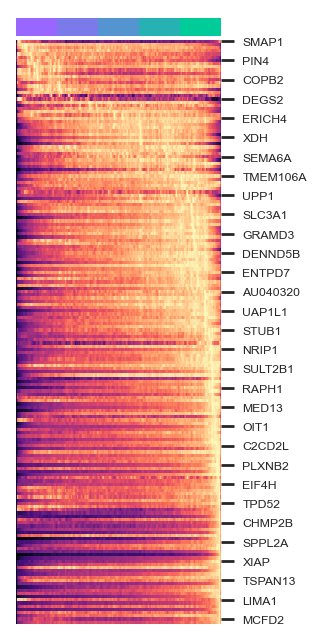

saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_5velo_v1tov5.png


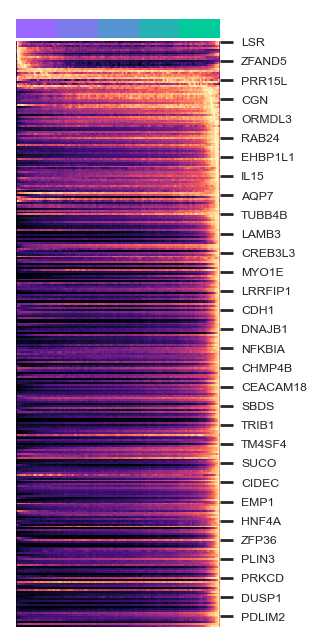

saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_1velo_v1tov5.pdf


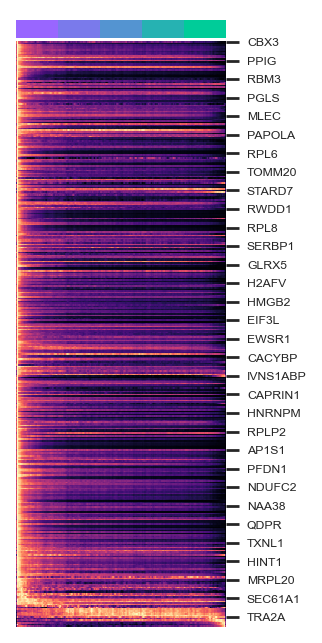

saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_2velo_v1tov5.pdf


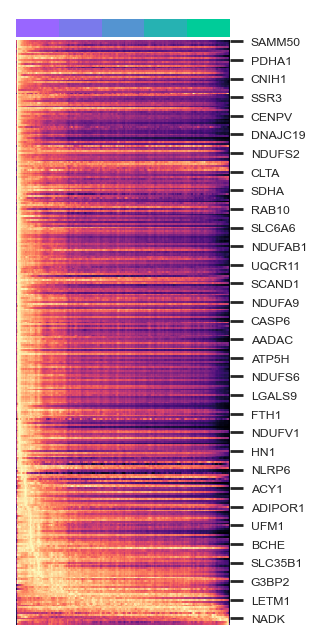

saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_3velo_v1tov5.pdf


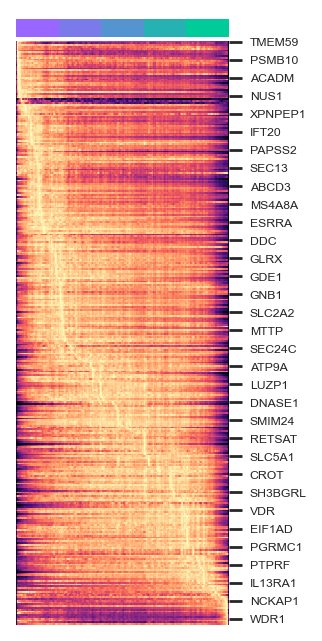

saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_4velo_v1tov5.pdf


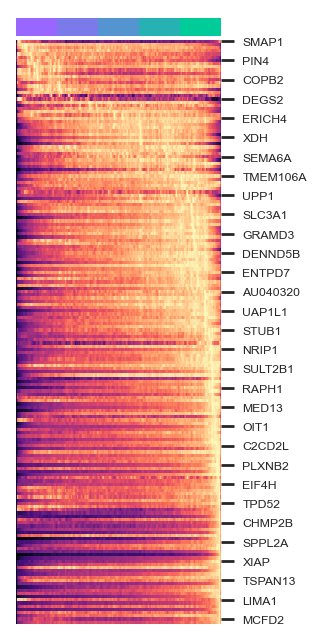

saving figure to file ./figures/scvelo_heatmap_mouse_all_enterocytes_Cluster_5velo_v1tov5.pdf


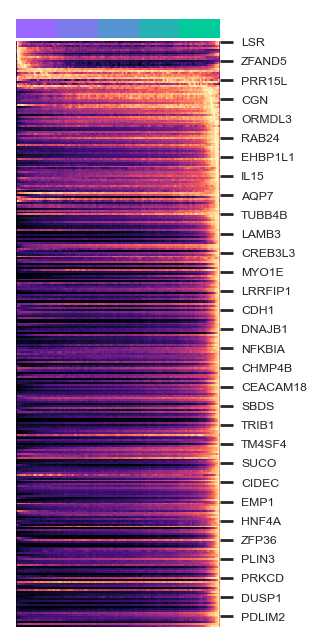

In [71]:
scv.pl.heatmap(mldata, var_names=mouse_clusters['Cluster 1'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[2,4],save='mouse_all_enterocytes_Cluster_1velo_v1tov5.pdf' ,font_scale=0.5)
scv.pl.heatmap(mldata, var_names=mouse_clusters['Cluster 2'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[2,4],save ='mouse_all_enterocytes_Cluster_2velo_v1tov5.pdf',font_scale=0.5)
scv.pl.heatmap(mldata, var_names=mouse_clusters['Cluster 3'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[2,4],save = 'mouse_all_enterocytes_Cluster_3velo_v1tov5.pdf',font_scale=0.5)
scv.pl.heatmap(mldata, var_names=mouse_clusters['Cluster 4'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[2,4],save = 'mouse_all_enterocytes_Cluster_4velo_v1tov5.pdf',font_scale=0.5)
scv.pl.heatmap(mldata, var_names=mouse_clusters['Cluster 5'], sortby='X_pca1', col_color='villi_axis', n_convolve=100,color_map='magma',figsize=[2,4],save = 'mouse_all_enterocytes_Cluster_5velo_v1tov5.pdf',font_scale=0.5)